In [1]:
import meep as mp
import meep.adjoint as mpa
from meep import Animate2D
import numpy as np
from autograd import numpy as npa
from autograd import tensor_jacobian_product, grad
import nlopt
from matplotlib import pyplot as plt
from matplotlib.patches import Circle
from meep.materials import Ag
import os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from PIL import Image
#from meep.materials import c-Si


os.makedirs(f'PICTURE',exist_ok=True)
mp.verbosity(0)
TiO2 = mp.Medium(index=2.6)
SiO2 = mp.Medium(index=1.44)
Si = mp.Medium(index=3.4)
Air = mp.Medium(index=1)

In [2]:
resolution = 100
design_region_resolution = int(resolution)

design_region_x_width  = 1   #100 nm
design_region_y_height = 1   #100 nm
design_region_z_height = 0.02  #20 nm or 10nm

pml_size = 1.0
pml_layers = [mp.PML(pml_size,direction=mp.Z)]

Sz_size = 0.6
Sx = design_region_x_width
Sy = design_region_y_height 
Sz = 2 * pml_size + design_region_z_height + Sz_size
cell_size = mp.Vector3(Sx, Sy, Sz)

wavelengths = np.array([1.55])     # wavelengths = np.array([1.5 ,1.55, 1.6])
frequencies = np.array([1 / 1.55])

nf = 1                 #3 #wavelengths Number

minimum_length = 0.01  # minimum length scale (microns)
eta_i = 0.5            # blueprint (or intermediate) design field thresholding point (between 0 and 1)
eta_e = 0.55           # erosion design field thresholding point (between 0 and 1)
eta_d = 1 - eta_e      # dilation design field thresholding point (between 0 and 1)
filter_radius = mpa.get_conic_radius_from_eta_e(minimum_length, eta_e)

Source_distance = -0.2

fcen   = 1 / 1.55
width  = 0.2  
fwidth = width * fcen
source_center = mp.Vector3(0,0,Source_distance)  
source_size   = mp.Vector3(design_region_x_width, design_region_y_height, 0)
src    = mp.GaussianSource(frequency=fcen, fwidth=fwidth, is_integrated=True)
source = [mp.Source(src, component=mp.Ey, size=source_size, center=source_center)]   

Nx = int(design_region_resolution * design_region_x_width) + 1
Ny = int(design_region_resolution * design_region_y_height) + 1
Nz = 1

design_variables = mp.MaterialGrid(mp.Vector3(Nx, Ny, Nz), Air, Si, grid_type="U_MEAN")
design_region    = mpa.DesignRegion(
            design_variables,
            volume=mp.Volume(
            center=mp.Vector3(0,0,0),
            size=mp.Vector3(design_region_x_width, design_region_y_height, design_region_z_height),
            ),
)

def mapping(x, eta, beta):
    # filter
    filtered_field = mpa.conic_filter(
        x,
        filter_radius,
        design_region_x_width,
        design_region_y_height,
        design_region_resolution,
    )
    # projection
    projected_field = mpa.tanh_projection(filtered_field, beta, eta)
    projected_field = (npa.fliplr(projected_field) + projected_field) / 2
    projected_field = (npa.flipud(projected_field) + projected_field) / 2  # left-right symmetry    
    
    return projected_field.flatten()


geometry = [mp.Block(center=design_region.center, size=design_region.size, material=design_variables)]

kpoint = mp.Vector3()  # Periodic Boundary
sim = mp.Simulation(
    cell_size        = cell_size,
    boundary_layers  = pml_layers,
    geometry         = geometry,
    sources          = source,
    default_material = Air,
    k_point          = kpoint,
    symmetries       = [mp.Mirror(direction=mp.X)], 
    resolution       = resolution,
    extra_materials  = [Ag],       # Introducing metal complex terms
)
#---------------------------------------------------------------------------------------------------#


#-----------------[4]---------------------------------#
monitor_position   = mp.Vector3(0, 0, 0)       # Focus position
monitor_size       = mp.Vector3(0.01,0.01,0.01)     # Focus Size//////0.11
FourierFields_x    = mpa.FourierFields(sim,mp.Volume(center=monitor_position,size=monitor_size),mp.Ex,yee_grid=False)
FourierFields_y    = mpa.FourierFields(sim,mp.Volume(center=monitor_position,size=monitor_size),mp.Ey,yee_grid=False)
FourierFields_z    = mpa.FourierFields(sim,mp.Volume(center=monitor_position,size=monitor_size),mp.Ez,yee_grid=False)
ob_list            = [FourierFields_x,FourierFields_y,FourierFields_z]


def J(fields_x,fields_y,fields_z):
    ET_x = npa.abs(fields_x) ** 2
    ET_y = npa.abs(fields_y) ** 2
    ET_z = npa.abs(fields_z) ** 2
    ET = npa.sqrt( npa.mean(ET_x) + npa.mean(ET_y) + npa.mean(ET_z) )  
    return ET


opt = mpa.OptimizationProblem(
    simulation=sim,
    objective_functions=[J],
    objective_arguments=ob_list,
    design_regions=[design_region],
    frequencies=frequencies,
    decimation_factor = 1 ,           # KEY BUG!!
    maximum_run_time=50,
)

[0.50007299 0.50005088 0.50004187 ... 0.50004187 0.50005088 0.50007299]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


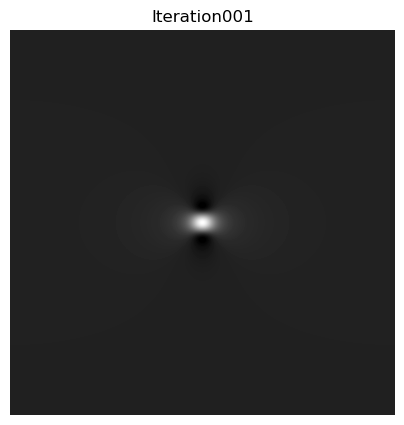

[0.50085587 0.50059712 0.50049161 ... 0.50049161 0.50059712 0.50085587]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


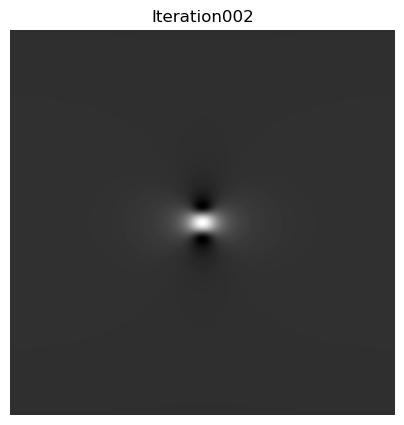

[0.51985245 0.51409983 0.51170207 ... 0.51170207 0.51409983 0.51985245]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


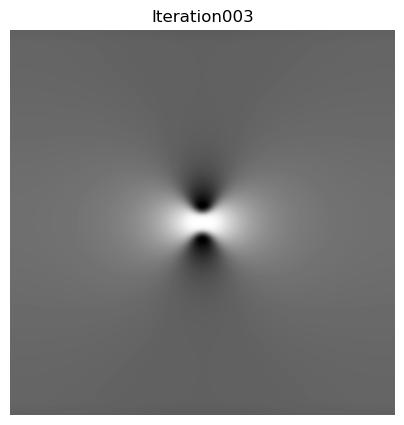

[1. 1. 1. ... 1. 1. 1.]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


/home/ming/anaconda3/envs/mp/lib/python3.8/site-packages/meep/geom.py:588: UserWarning: The weights parameter of MaterialGrid must be in the range [0,1].
  warnings.warn(


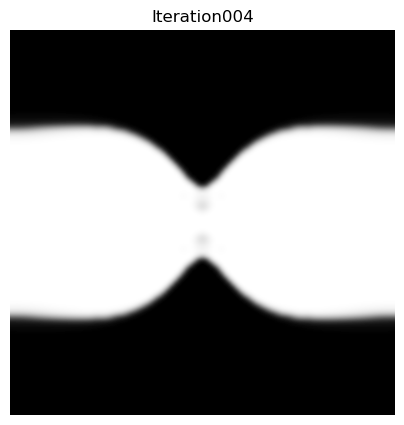

[0.93024986 0.88467733 0.86180555 ... 0.86180555 0.88467733 0.93024986]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


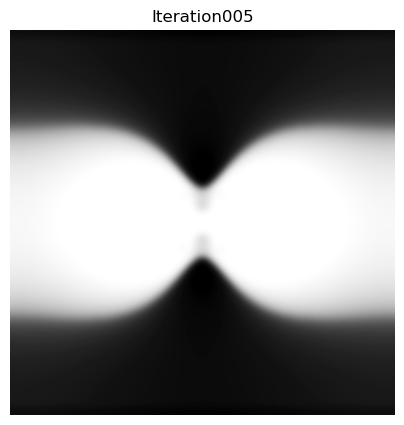

[0.66254686 0.62624434 0.61045753 ... 0.61045753 0.62624434 0.66254686]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


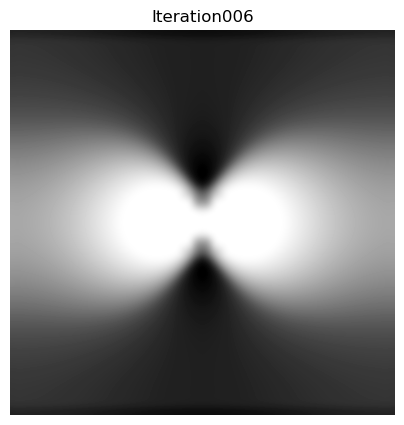

[0.54077643 0.52918168 0.52449952 ... 0.52449952 0.52918168 0.54077643]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


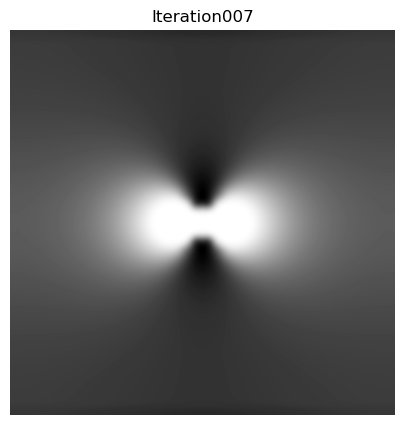

[0.5220584  0.5156664  0.51302368 ... 0.51302368 0.5156664  0.5220584 ]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


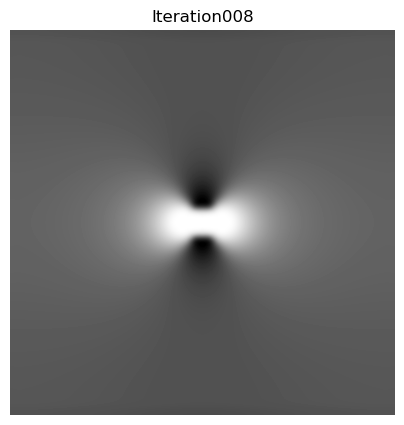

[0.52015893 0.51431714 0.51188529 ... 0.51188529 0.51431714 0.52015893]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


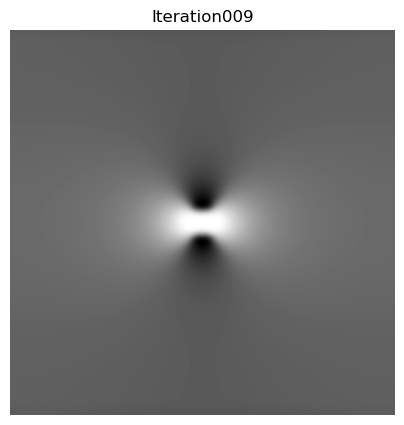

[0.51990687 0.51413841 0.51173459 ... 0.51173459 0.51413841 0.51990687]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


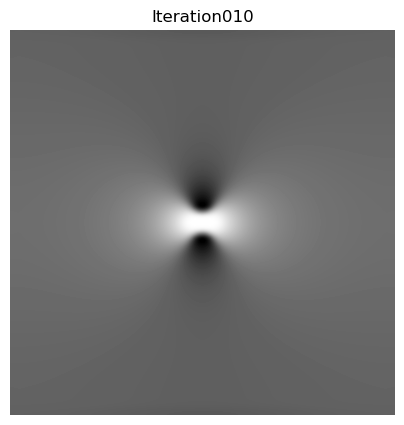

[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


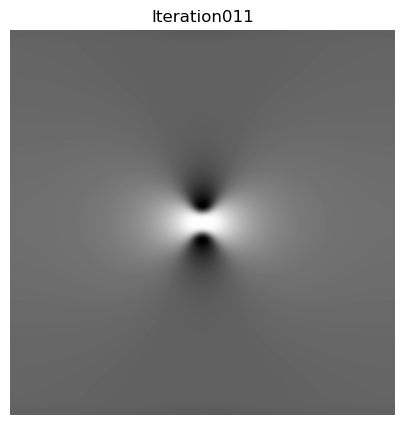

[0.5198724  0.51411397 0.51171398 ... 0.51171398 0.51411397 0.5198724 ]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


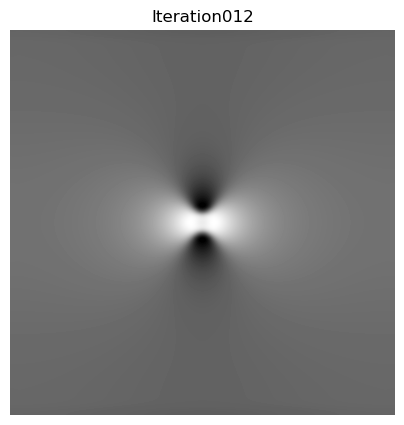

[0.51986716 0.51411026 0.51171086 ... 0.51171086 0.51411026 0.51986716]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


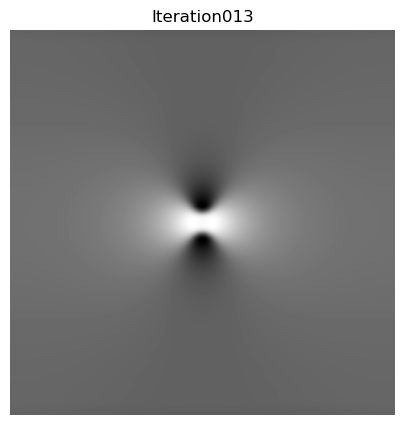

[0.51986532 0.51410895 0.51170976 ... 0.51170976 0.51410895 0.51986532]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


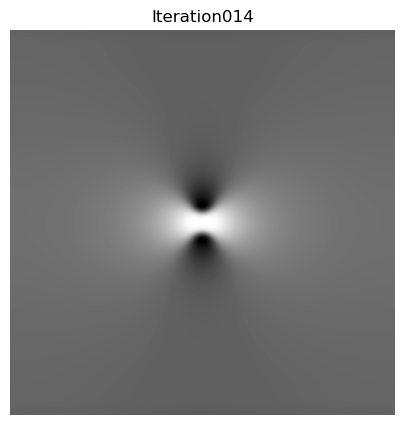

[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


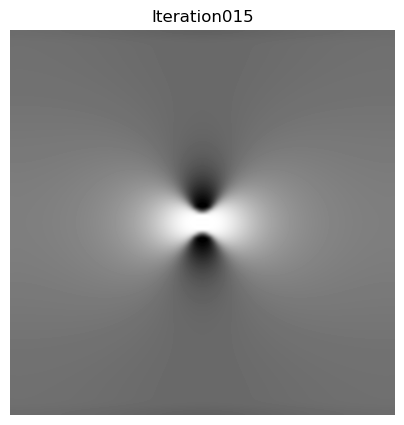

[0.52289773 0.51630101 0.5136024  ... 0.5136024  0.51630101 0.52289773]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


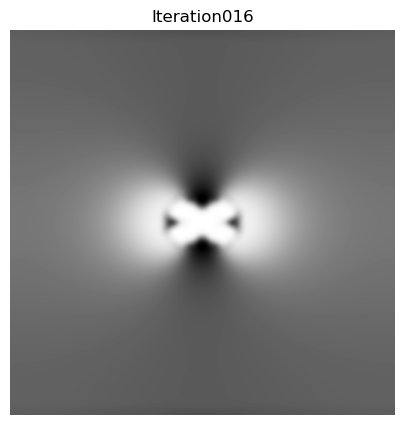

[0.52017094 0.51432922 0.51189975 ... 0.51189975 0.51432922 0.52017094]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


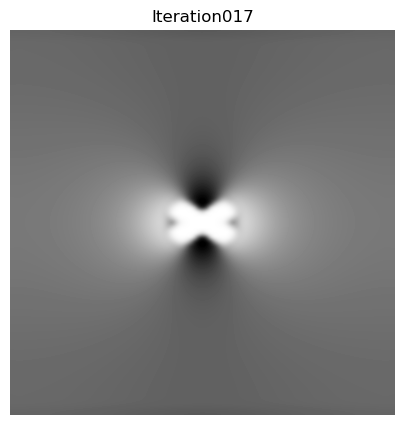

[0.52021329 0.51435965 0.51192582 ... 0.51192582 0.51435965 0.52021329]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


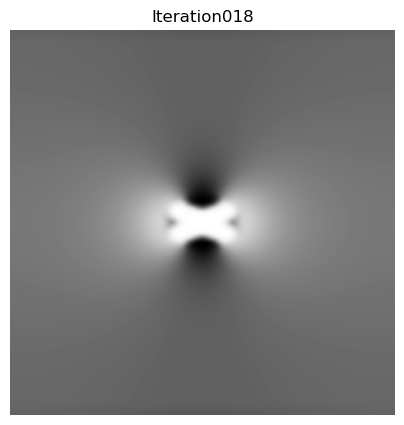

[0.52018302 0.5143379  0.51190719 ... 0.51190719 0.5143379  0.52018302]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


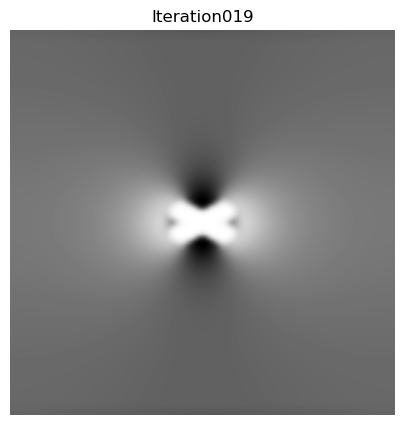

[0.52017454 0.5143318  0.51190196 ... 0.51190196 0.5143318  0.52017454]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


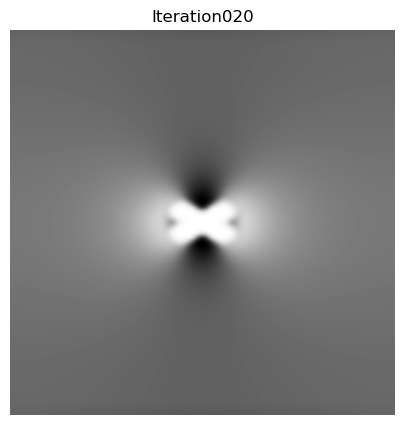

[0.5201805  0.51433609 0.51190563 ... 0.51190563 0.51433609 0.5201805 ]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


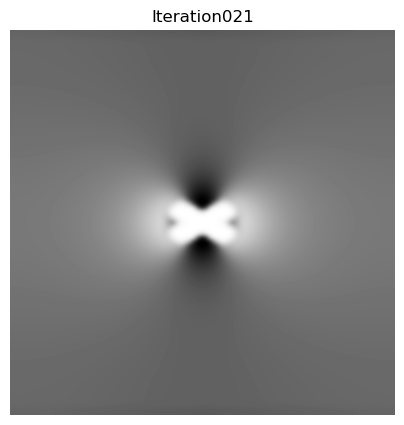

[0.52017708 0.51433363 0.51190353 ... 0.51190353 0.51433363 0.52017708]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


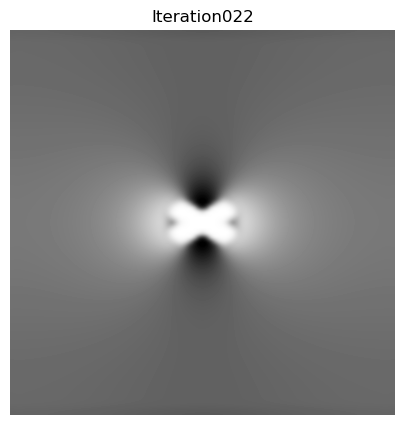

[0.52017873 0.51433482 0.51190454 ... 0.51190454 0.51433482 0.52017873]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


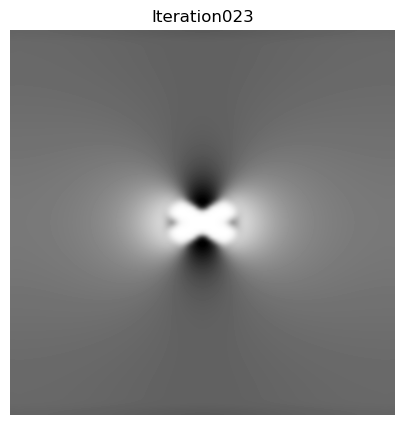

[0.52017972 0.51433553 0.51190515 ... 0.51190515 0.51433553 0.52017972]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


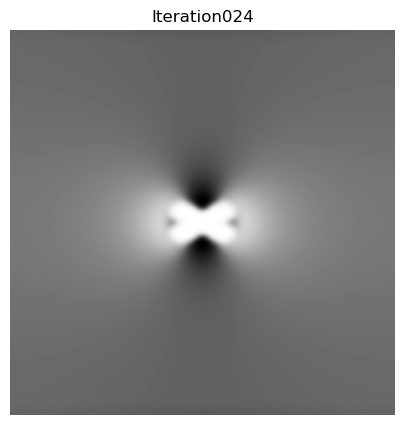

[0.52018054 0.51433612 0.51190566 ... 0.51190566 0.51433612 0.52018054]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


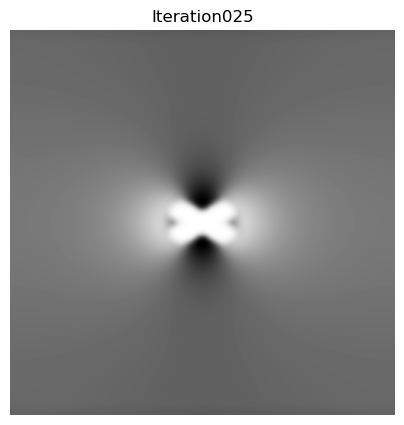

[0.52018114 0.51433655 0.51190603 ... 0.51190603 0.51433655 0.52018114]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


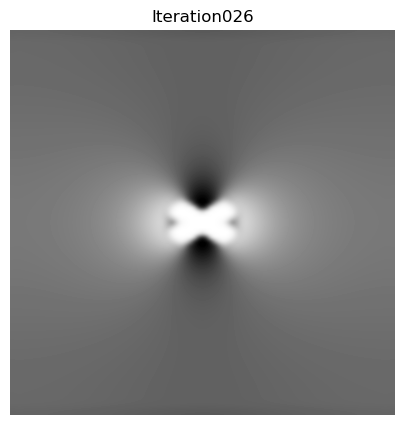

[0.52018155 0.51433684 0.51190628 ... 0.51190628 0.51433684 0.52018155]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


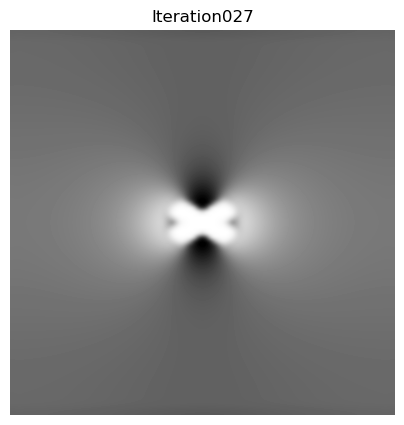

[0.52018185 0.51433706 0.51190647 ... 0.51190647 0.51433706 0.52018185]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


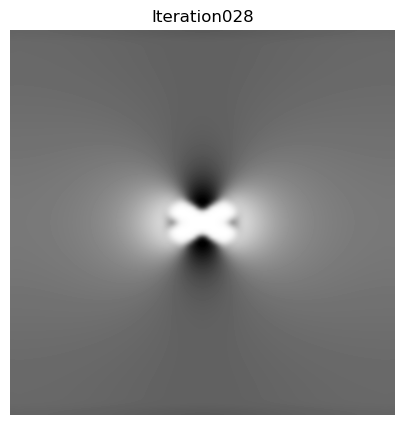

[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]
2
0.5
8
[0.51986426 0.5141082  0.51170912 ... 0.51170912 0.5141082  0.51986426]


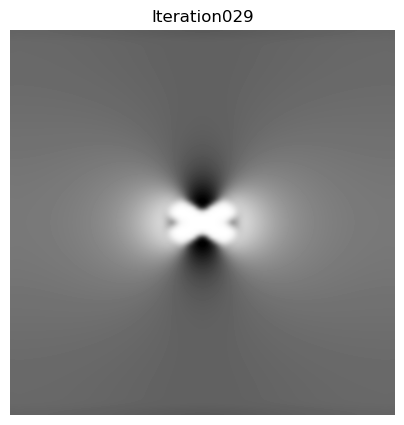

[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


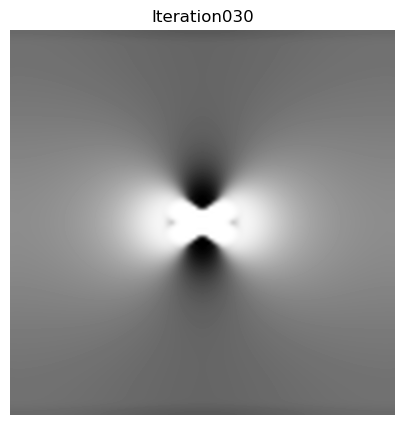

[0.52416036 0.51730134 0.51455787 ... 0.51455787 0.51730134 0.52416036]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


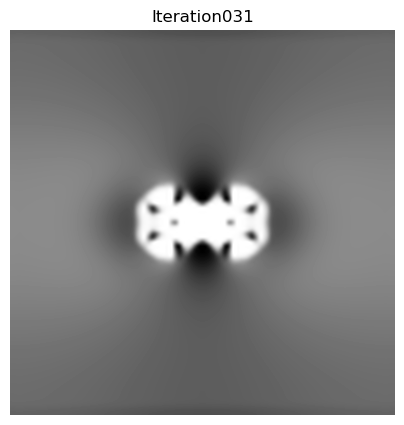

[0.52412581 0.517276   0.51453606 ... 0.51453606 0.517276   0.52412581]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


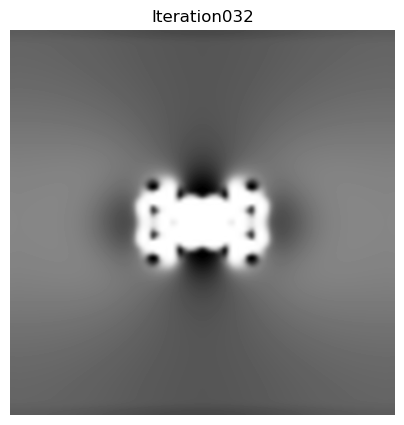

[0.52415336 0.5172962  0.51455345 ... 0.51455345 0.5172962  0.52415336]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


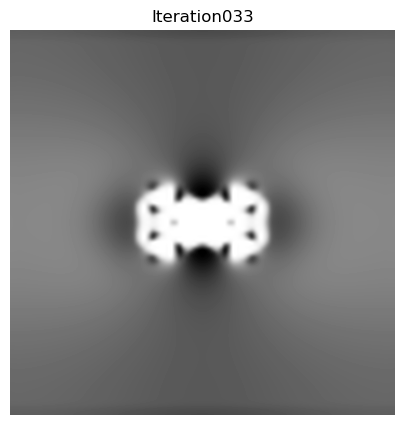

[0.52415828 0.51729981 0.51455655 ... 0.51455655 0.51729981 0.52415828]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


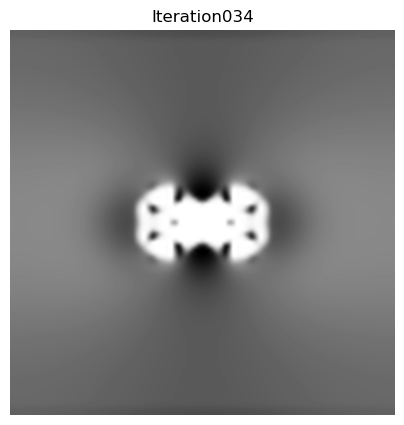

[0.52415965 0.51730082 0.51455742 ... 0.51455742 0.51730082 0.52415965]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


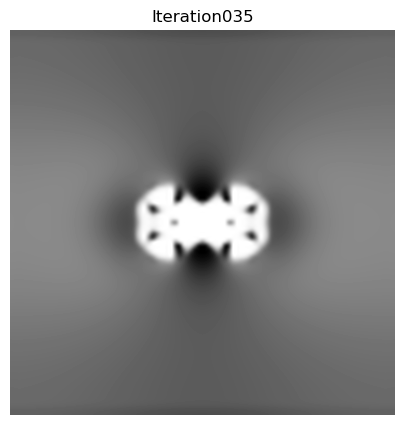

[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


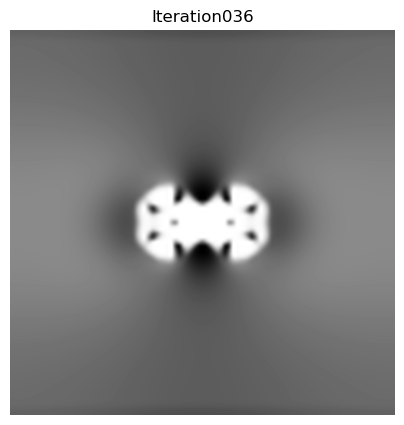

[0.52416002 0.51730108 0.51455764 ... 0.51455764 0.51730108 0.52416002]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


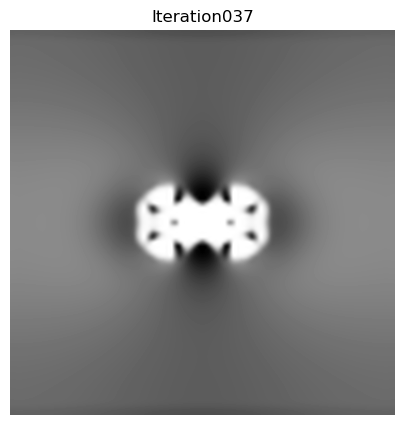

[0.52416007 0.51730112 0.51455768 ... 0.51455768 0.51730112 0.52416007]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


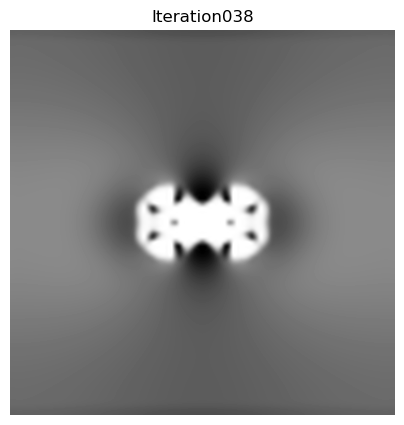

[0.52416008 0.51730113 0.51455769 ... 0.51455769 0.51730113 0.52416008]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


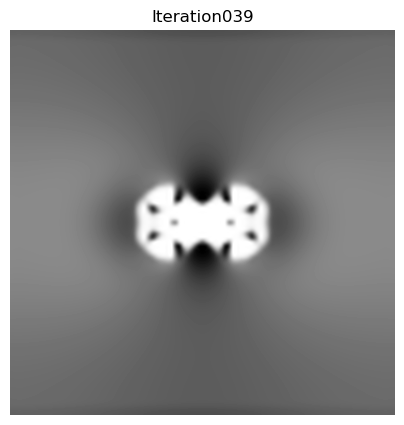

[0.52416009 0.51730114 0.5145577  ... 0.5145577  0.51730114 0.52416009]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


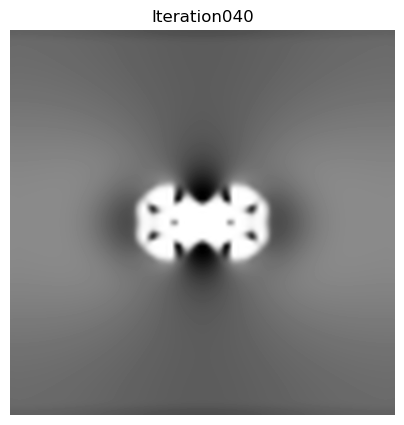

[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


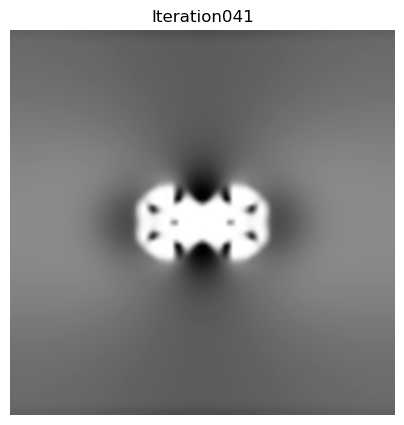

[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


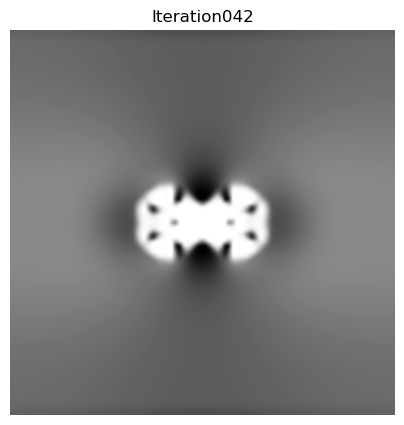

[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


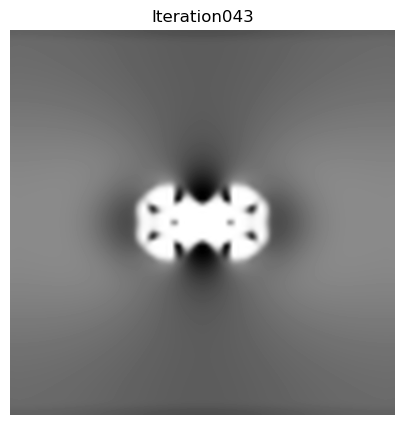

[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]
2
0.5
16
[0.52018207 0.51433722 0.5119066  ... 0.5119066  0.51433722 0.52018207]


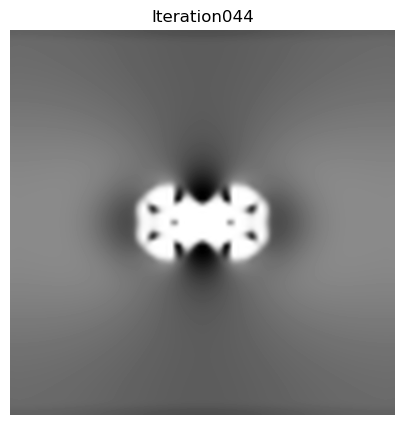

[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


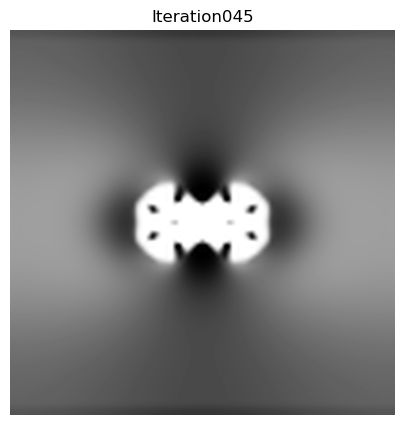

[0.52528691 0.51822105 0.51548239 ... 0.51548239 0.51822105 0.52528691]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


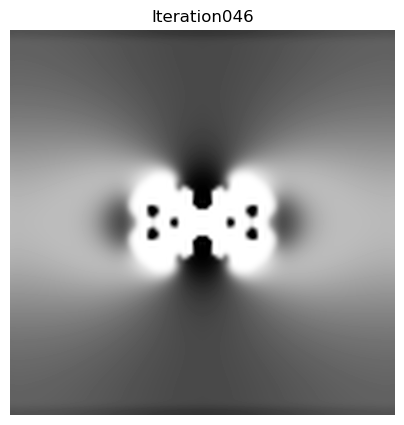

[0.52550387 0.51839805 0.51565954 ... 0.51565954 0.51839805 0.52550387]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


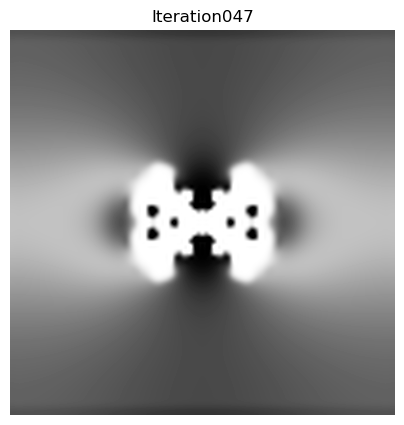

[0.52557772 0.51845832 0.51571988 ... 0.51571988 0.51845832 0.52557772]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


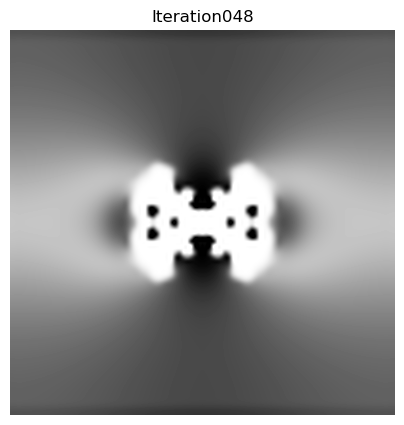

[0.52553003 0.51841939 0.51568091 ... 0.51568091 0.51841939 0.52553003]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


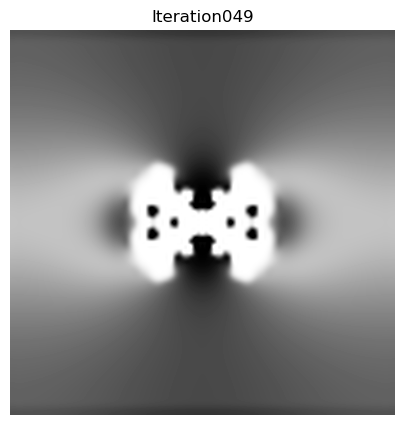

[0.52554843 0.51843442 0.51569596 ... 0.51569596 0.51843442 0.52554843]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


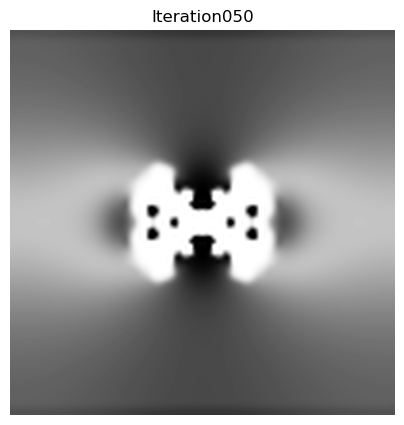

[0.5255342  0.5184228  0.51568432 ... 0.51568432 0.5184228  0.5255342 ]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


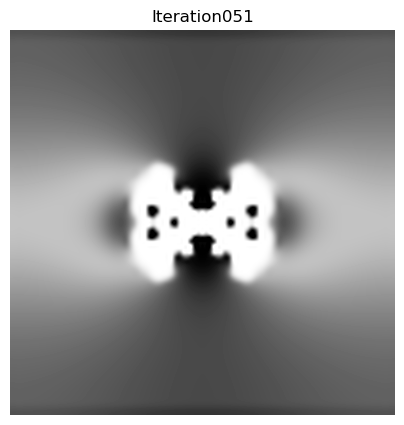

[0.52558586 0.51846498 0.51572657 ... 0.51572657 0.51846498 0.52558586]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


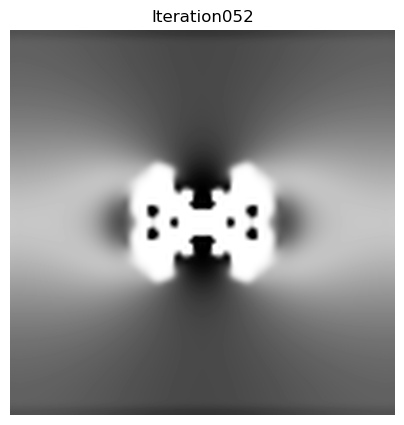

[0.52554964 0.51843541 0.51569695 ... 0.51569695 0.51843541 0.52554964]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


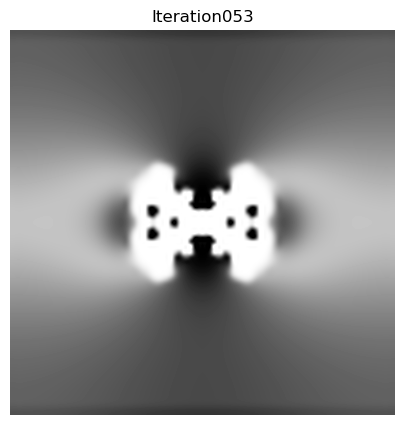

[0.52553797 0.51842588 0.5156874  ... 0.5156874  0.51842588 0.52553797]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


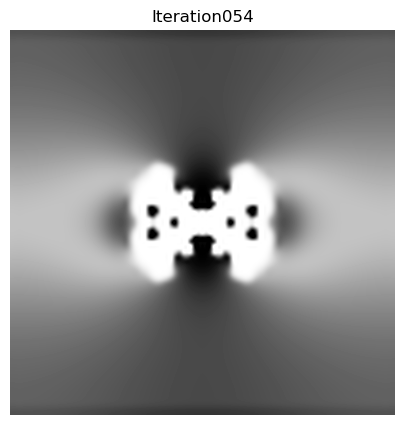

[0.52558672 0.51846571 0.51572736 ... 0.51572736 0.51846571 0.52558672]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


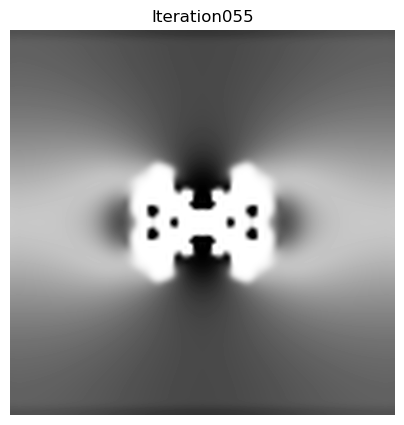

[0.52554918 0.51843504 0.51569659 ... 0.51569659 0.51843504 0.52554918]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


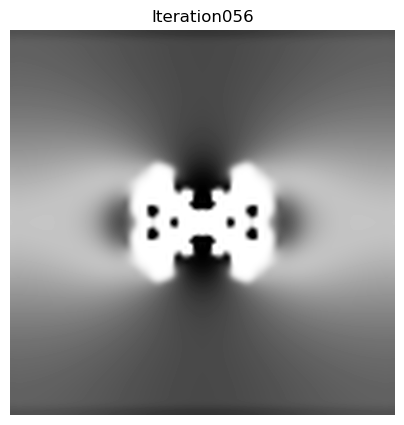

[0.5255392  0.51842688 0.51568841 ... 0.51568841 0.51842688 0.5255392 ]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


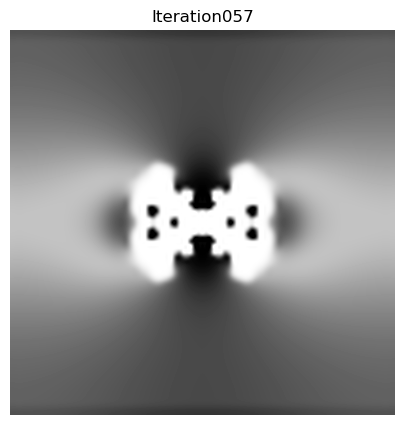

[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


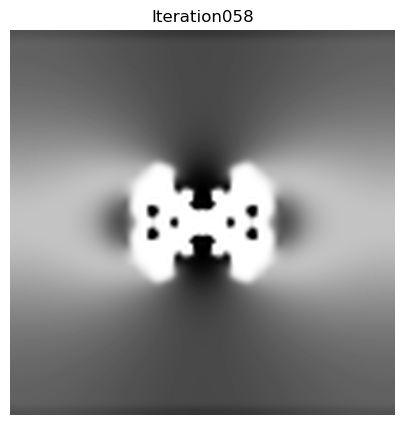

[0.52553829 0.51842614 0.51568767 ... 0.51568767 0.51842614 0.52553829]
2
0.5
32
[0.5241601  0.51730114 0.5145577  ... 0.5145577  0.51730114 0.5241601 ]


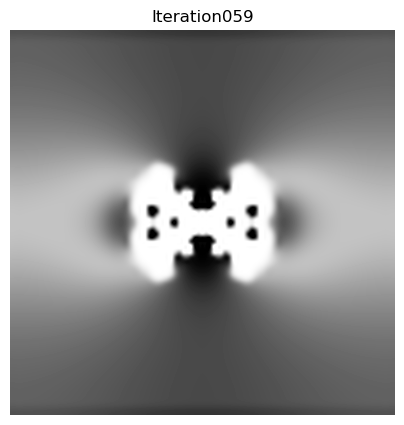

[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


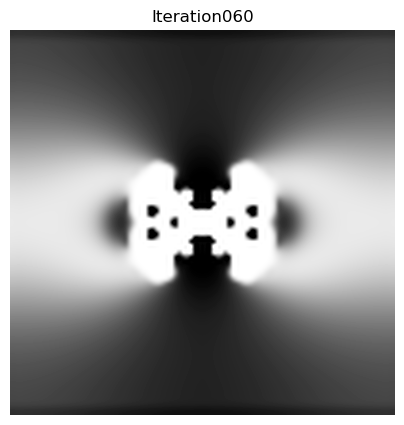

[0.52738536 0.52022622 0.5178441  ... 0.5178441  0.52022622 0.52738536]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


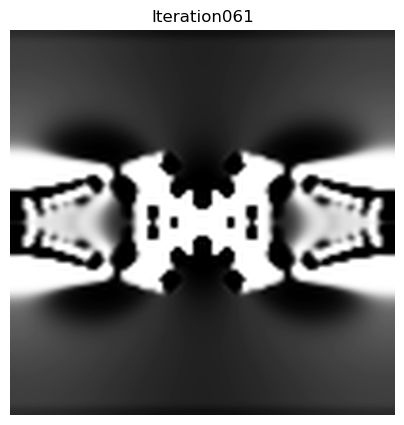

[0.52572412 0.51860723 0.5159049  ... 0.5159049  0.51860723 0.52572412]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


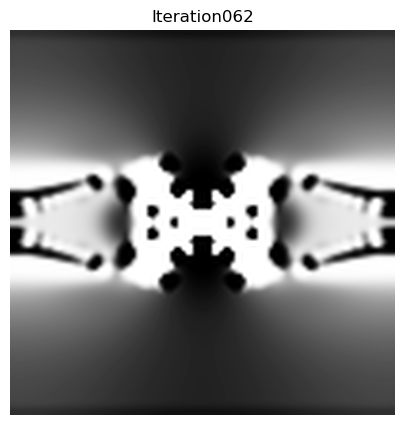

[0.52574449 0.51862702 0.51592854 ... 0.51592854 0.51862702 0.52574449]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


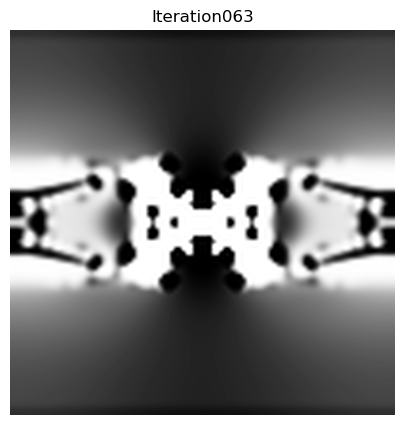

[0.52575397 0.51863626 0.51593962 ... 0.51593962 0.51863626 0.52575397]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


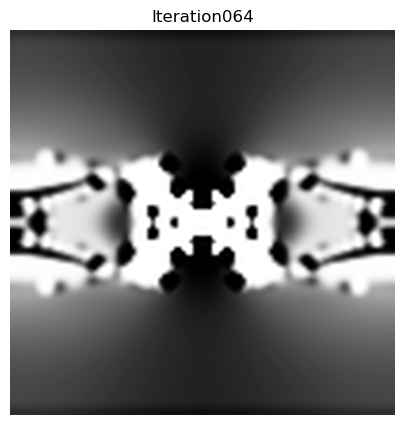

[0.52574813 0.51863057 0.5159328  ... 0.5159328  0.51863057 0.52574813]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


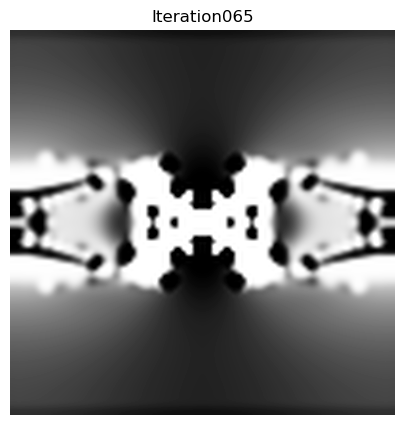

[0.52574601 0.51862851 0.51593032 ... 0.51593032 0.51862851 0.52574601]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


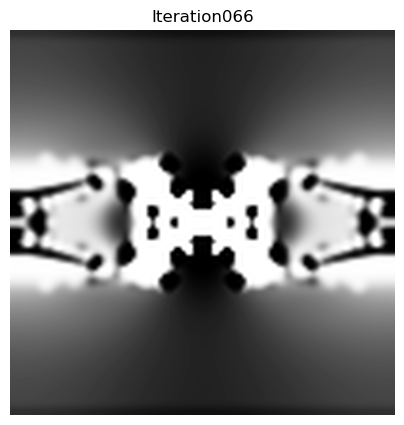

[0.52574515 0.51862767 0.51592931 ... 0.51592931 0.51862767 0.52574515]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


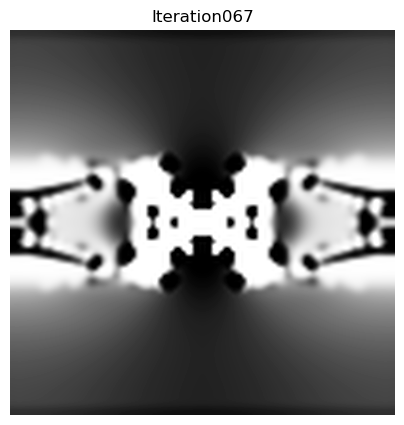

[0.52574479 0.51862731 0.51592888 ... 0.51592888 0.51862731 0.52574479]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


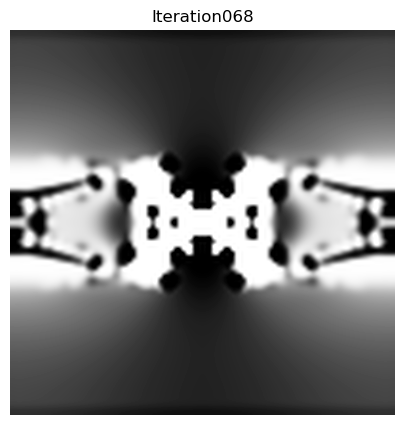

[0.52574462 0.51862715 0.51592869 ... 0.51592869 0.51862715 0.52574462]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


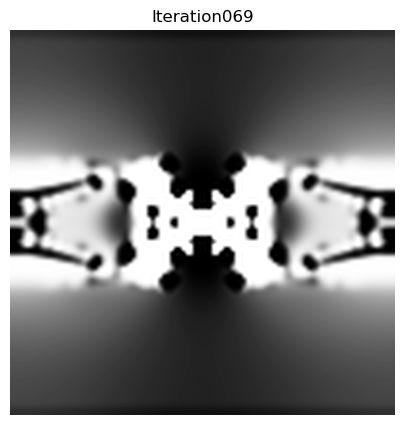

[0.52574455 0.51862708 0.5159286  ... 0.5159286  0.51862708 0.52574455]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


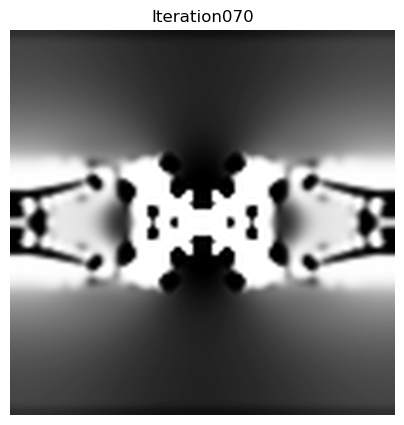

[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


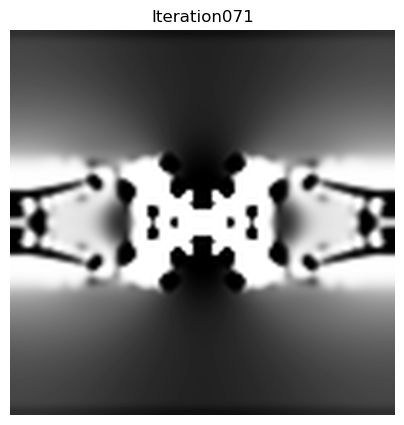

[0.52574459 0.51862712 0.51592865 ... 0.51592865 0.51862712 0.52574459]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


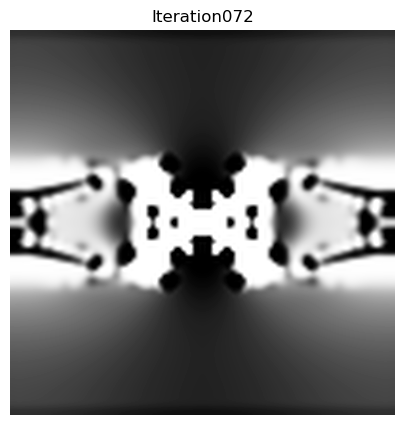

[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


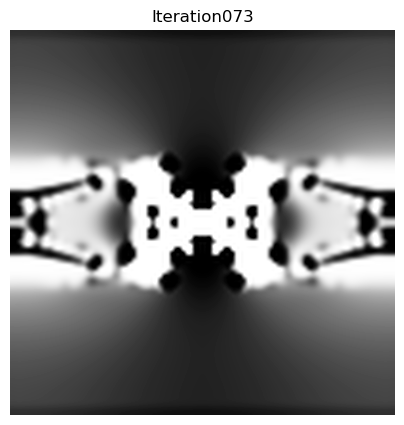

[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]
2
0.5
64
[0.52553816 0.51842604 0.51568756 ... 0.51568756 0.51842604 0.52553816]


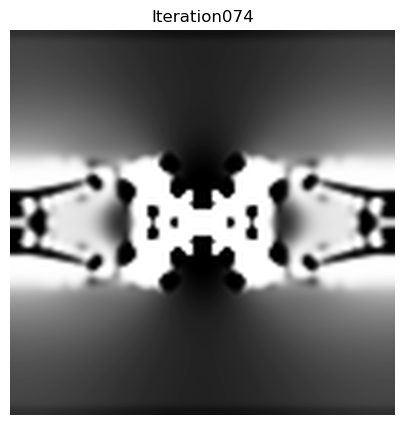

[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


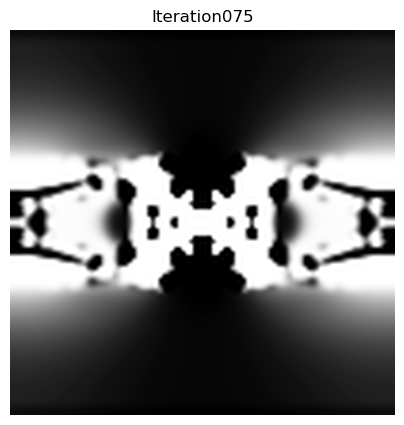

[0.52611197 0.51915632 0.51678358 ... 0.51678358 0.51915632 0.52611197]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


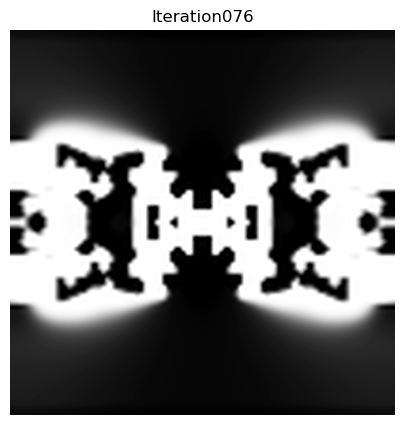

[0.52578711 0.51868841 0.51602778 ... 0.51602778 0.51868841 0.52578711]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


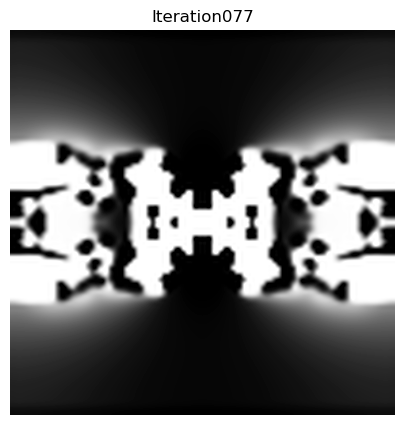

[0.52579261 0.51869626 0.51604035 ... 0.51604035 0.51869626 0.52579261]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


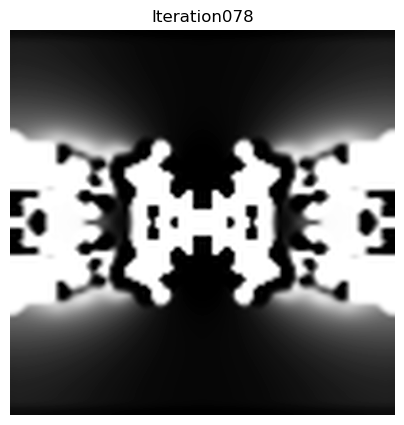

[0.52579234 0.51869588 0.51603972 ... 0.51603972 0.51869588 0.52579234]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


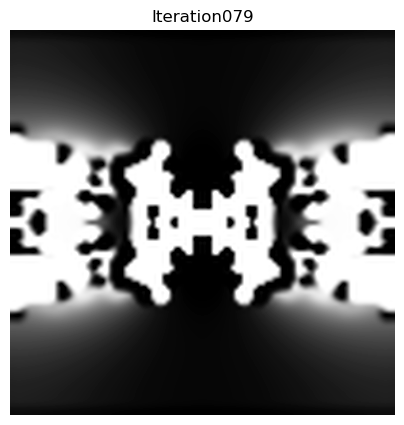

[0.52579253 0.51869615 0.51604016 ... 0.51604016 0.51869615 0.52579253]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


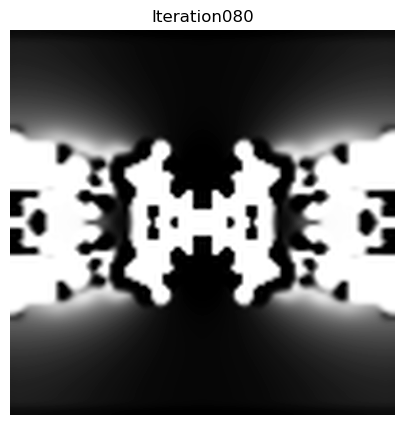

[0.52579249 0.51869608 0.51604006 ... 0.51604006 0.51869608 0.52579249]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


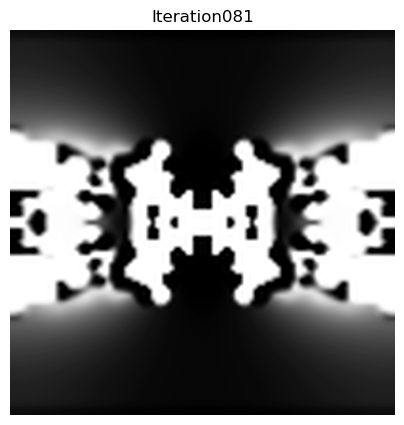

[0.52579251 0.51869612 0.51604012 ... 0.51604012 0.51869612 0.52579251]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


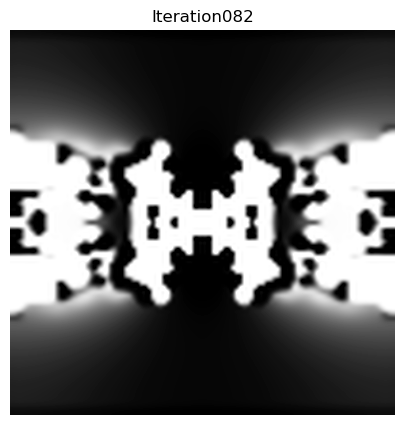

[0.52579252 0.51869614 0.51604014 ... 0.51604014 0.51869614 0.52579252]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


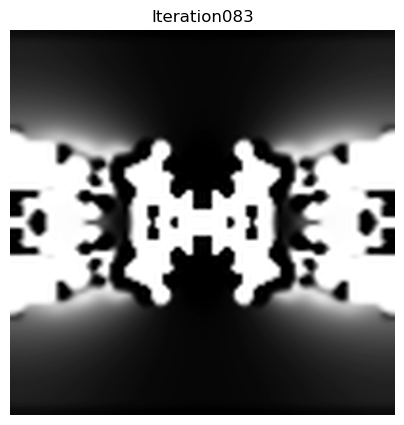

[0.52579253 0.51869614 0.51604015 ... 0.51604015 0.51869614 0.52579253]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


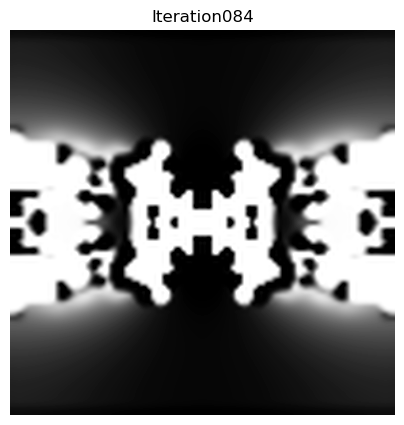

[0.52579253 0.51869615 0.51604016 ... 0.51604016 0.51869615 0.52579253]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


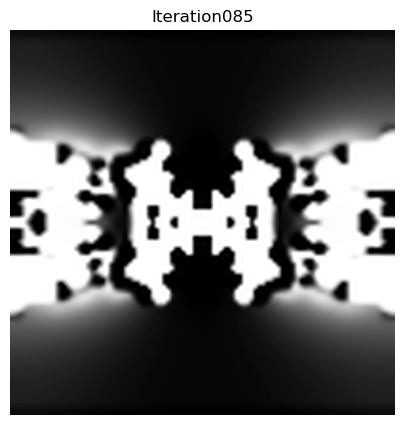

[0.52579253 0.51869615 0.51604016 ... 0.51604016 0.51869615 0.52579253]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


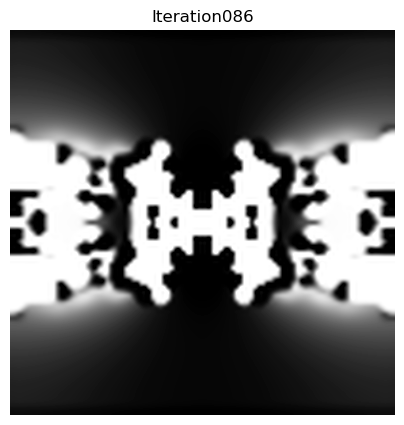

[0.52579253 0.51869615 0.51604016 ... 0.51604016 0.51869615 0.52579253]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


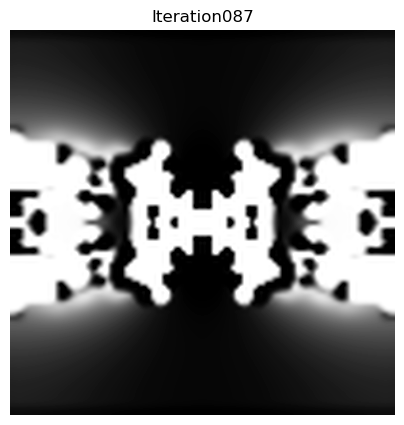

[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


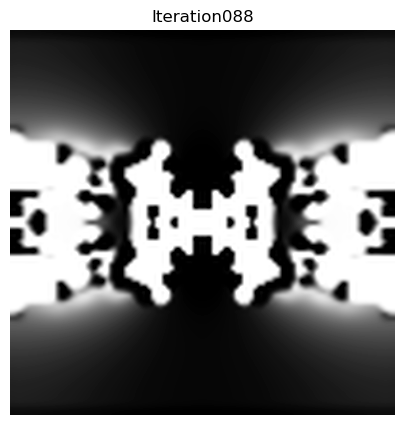

[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]
2
0.5
128
[0.52574458 0.51862711 0.51592864 ... 0.51592864 0.51862711 0.52574458]


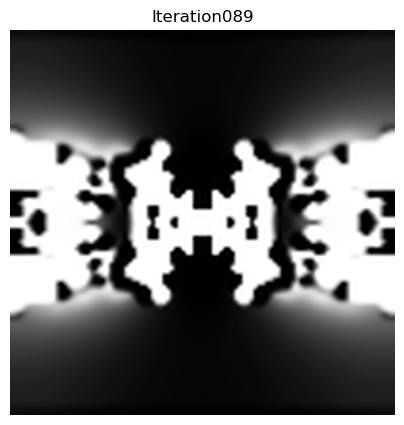

[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


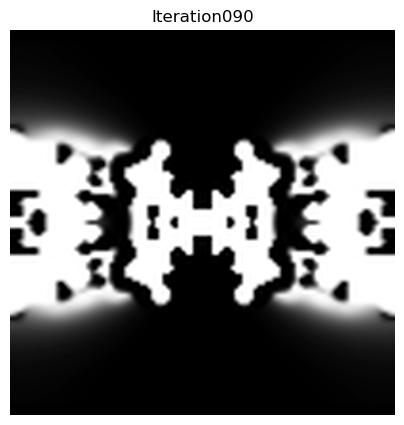

[0.52579359 0.51869955 0.51604838 ... 0.51604838 0.51869955 0.52579359]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


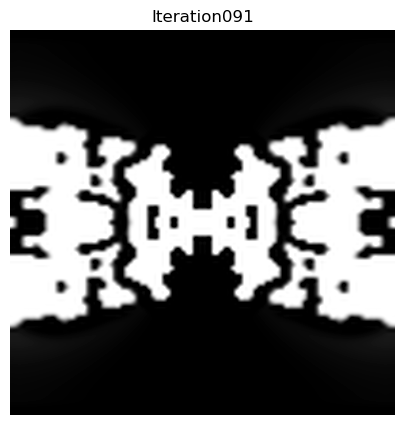

[0.52579263 0.51869649 0.51604098 ... 0.51604098 0.51869649 0.52579263]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


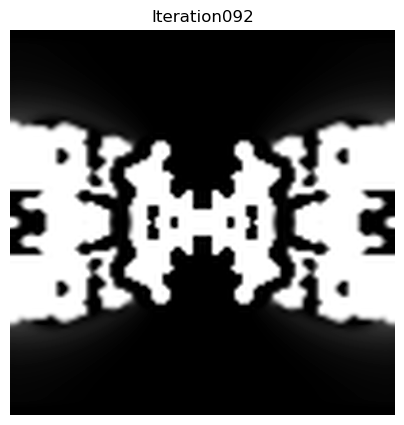

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


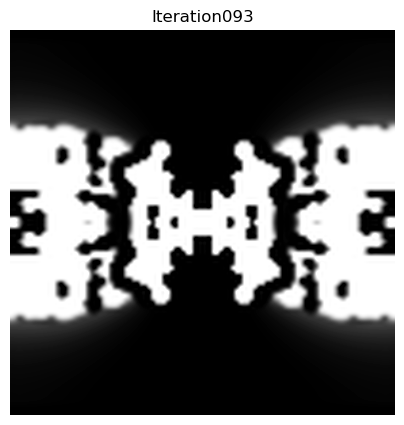

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


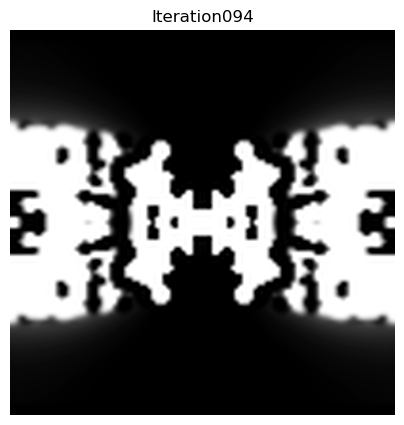

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


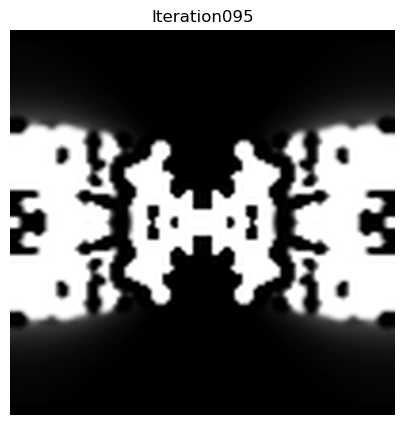

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


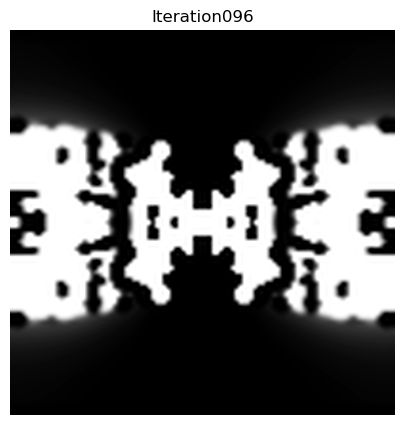

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


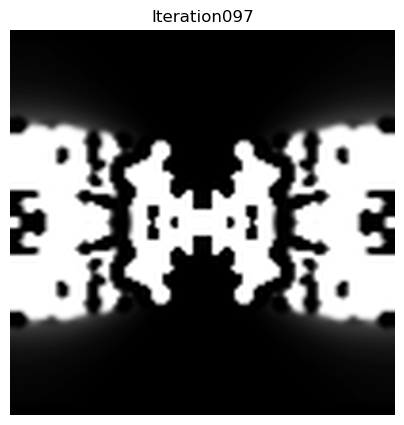

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


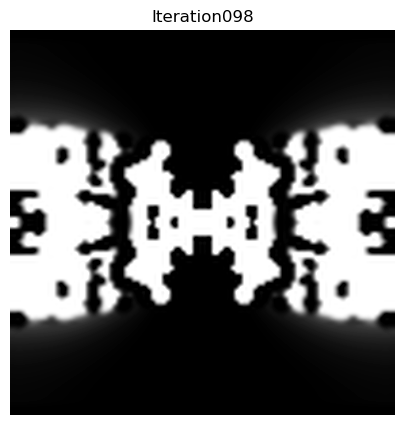

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


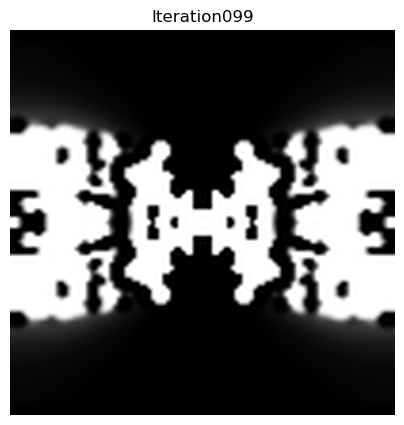

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


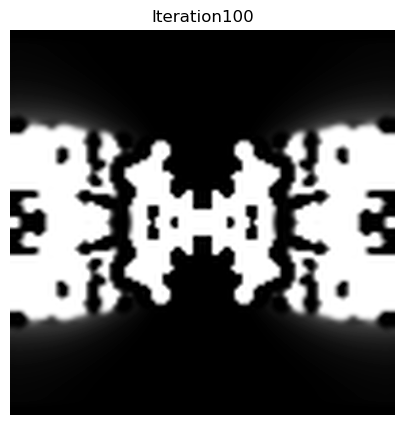

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


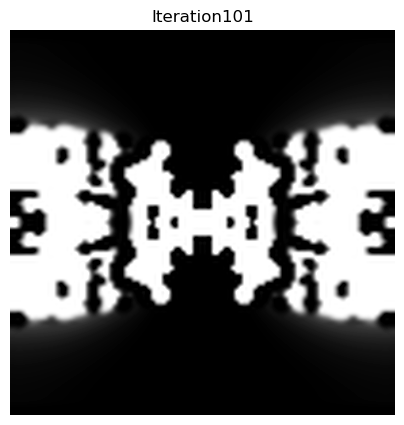

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


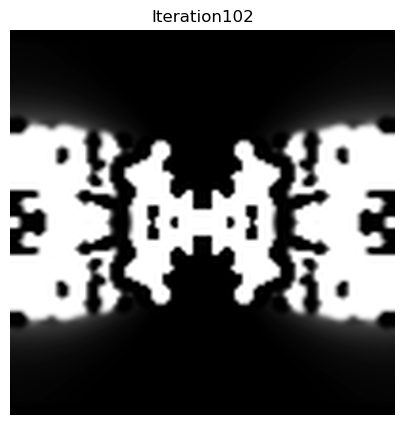

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


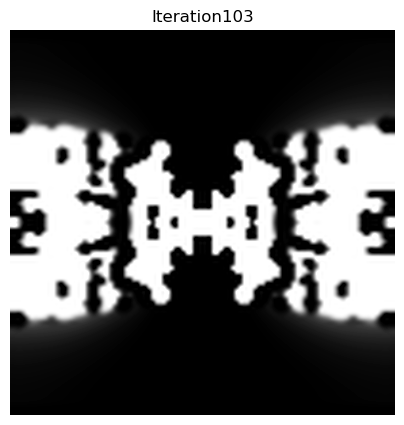

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
256
[0.52579253 0.51869614 0.51604016 ... 0.51604016 0.51869614 0.52579253]


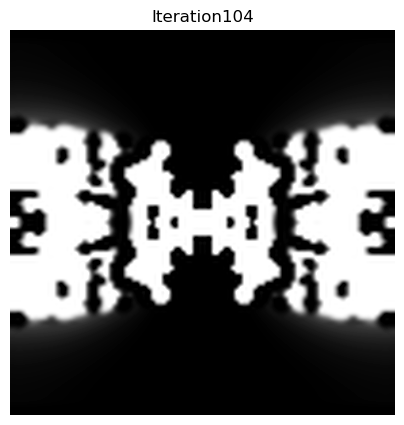

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


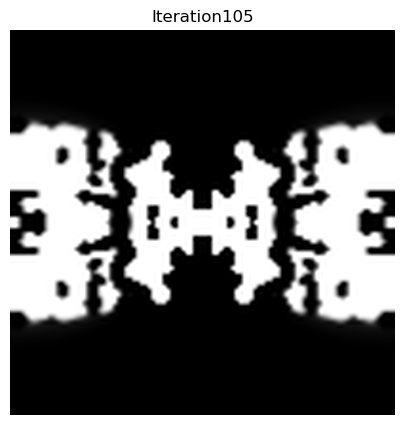

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


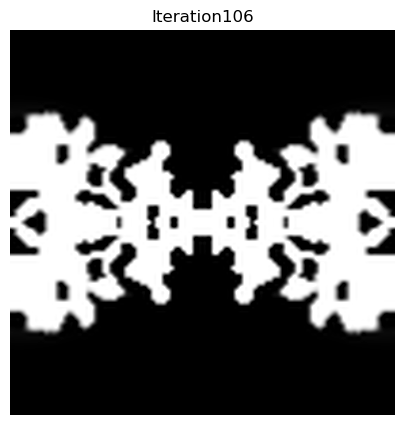

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


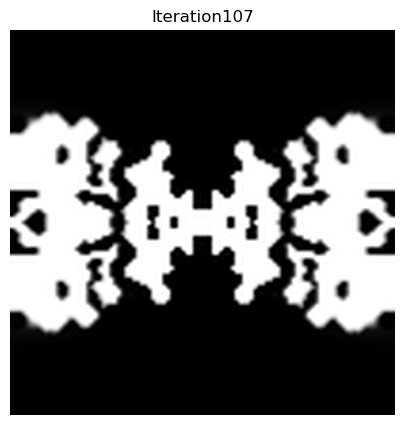

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


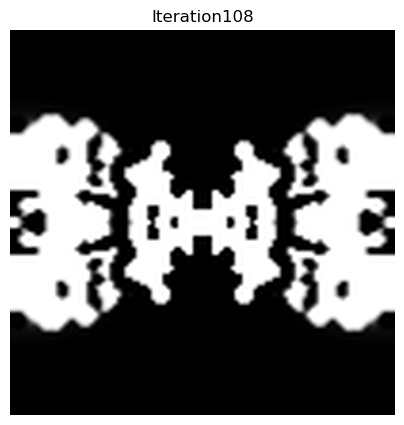

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


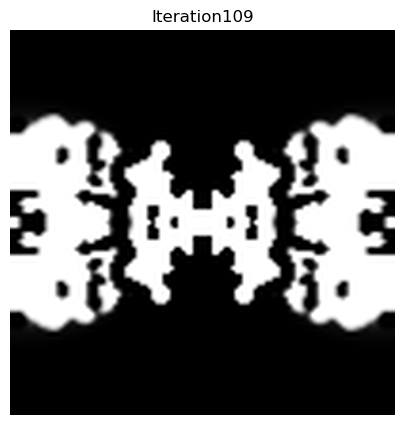

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


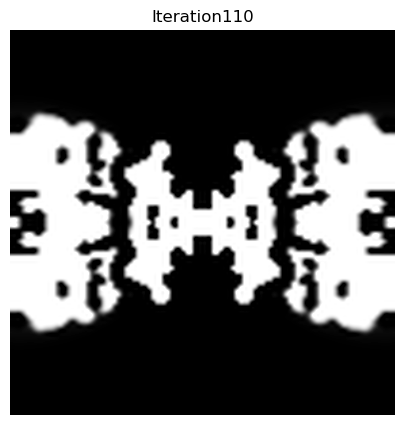

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


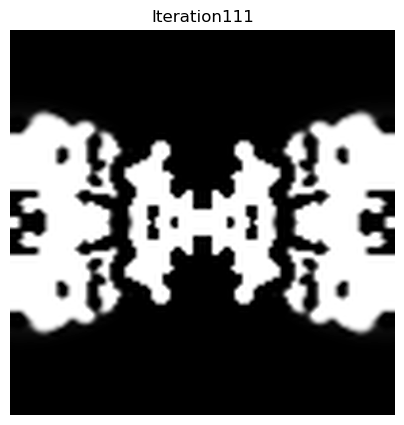

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


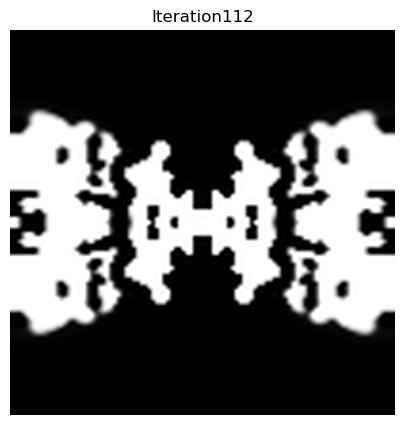

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


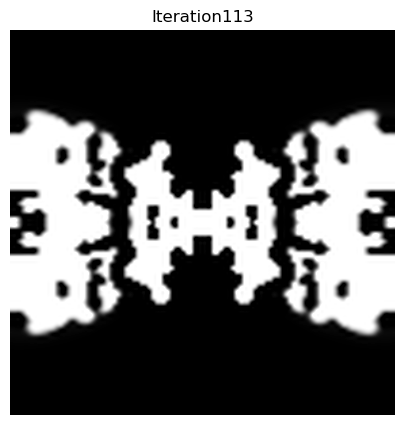

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


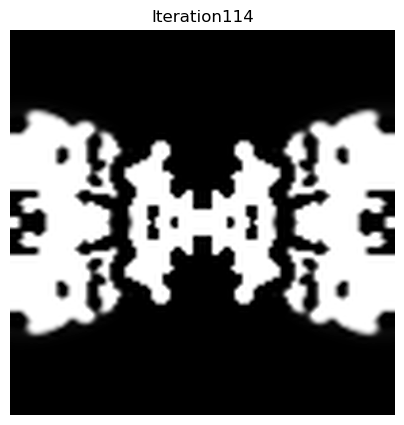

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


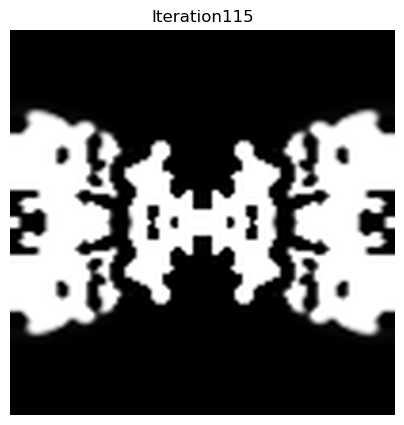

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


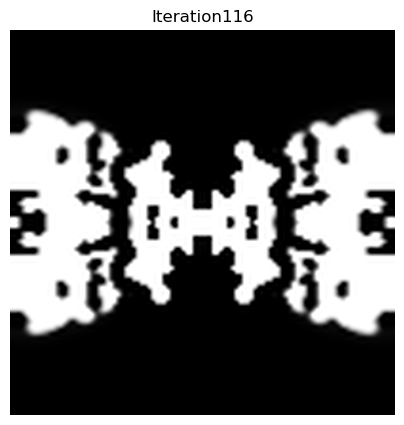

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


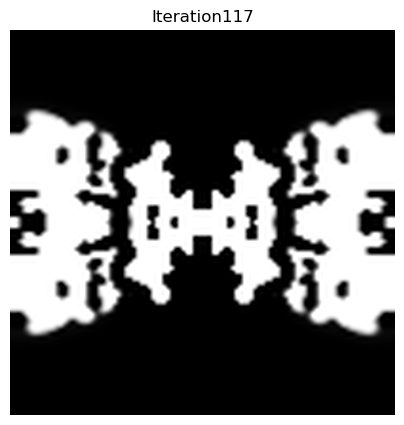

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


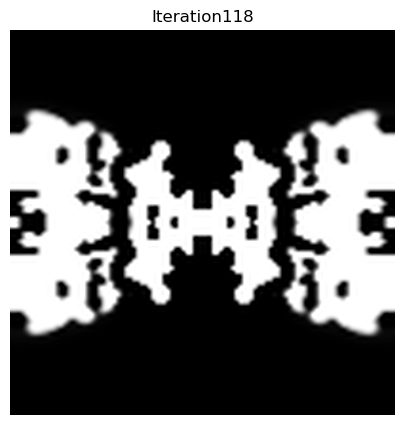

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
512
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


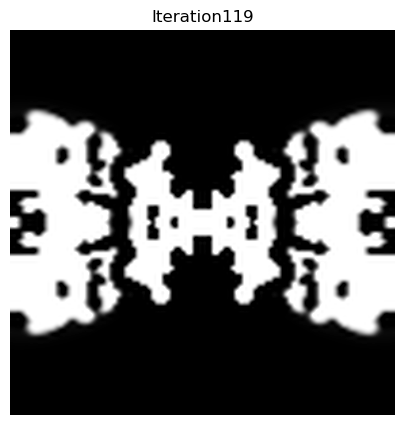

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


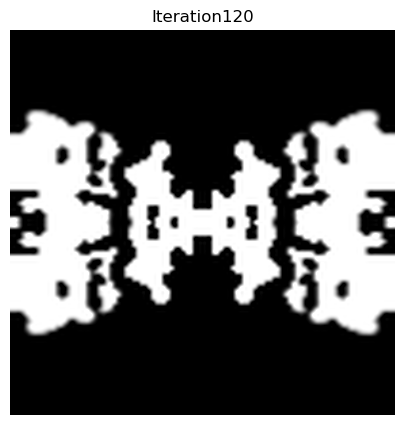

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


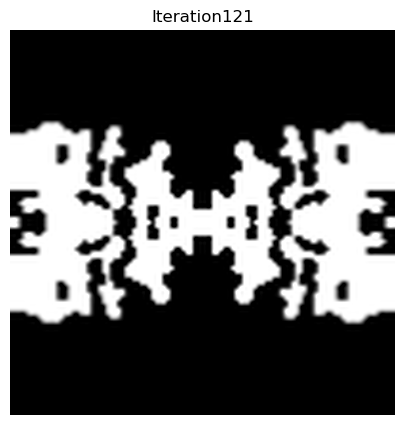

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


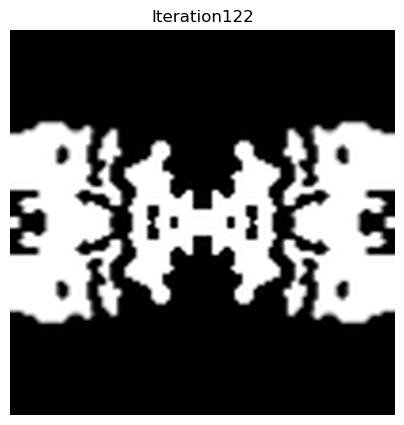

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


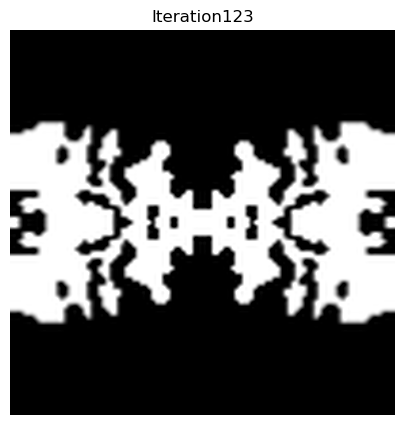

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


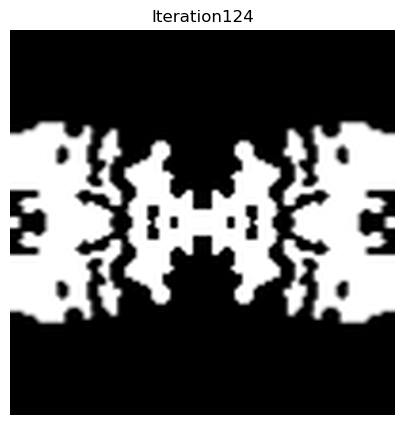

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


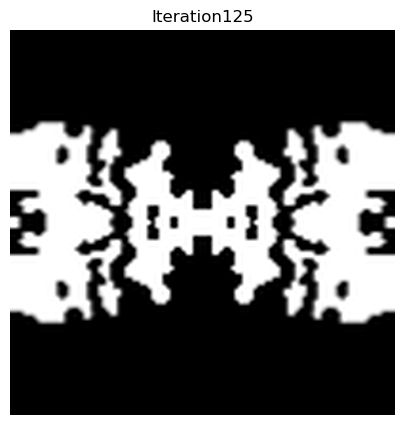

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


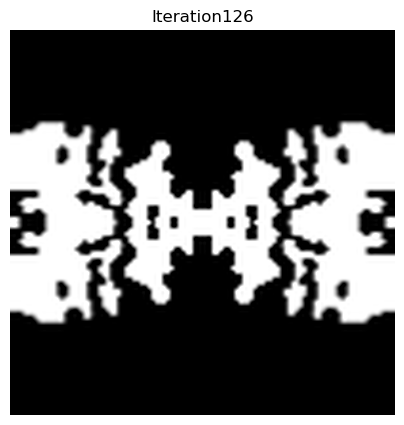

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


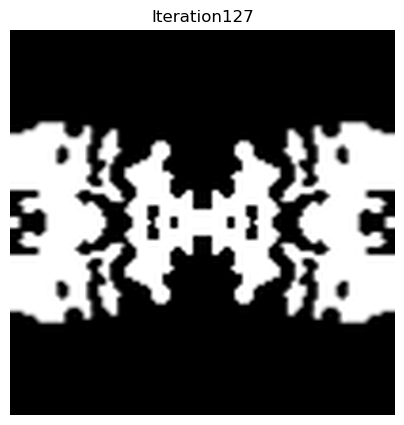

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


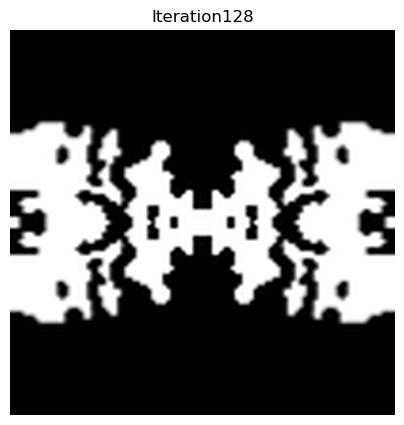

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


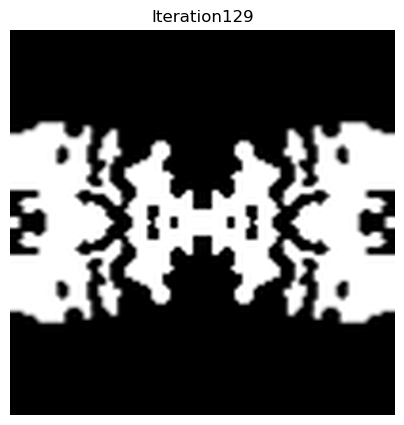

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


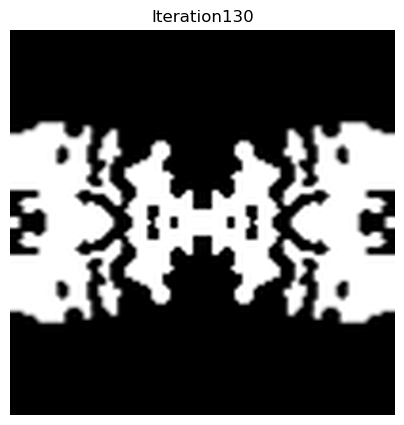

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


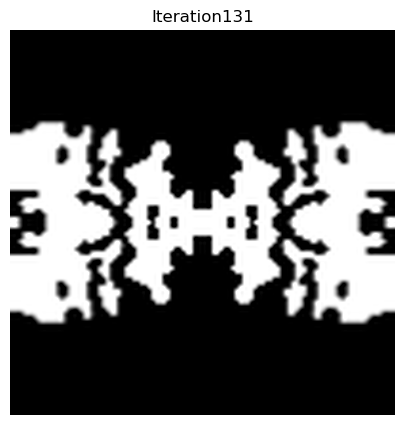

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


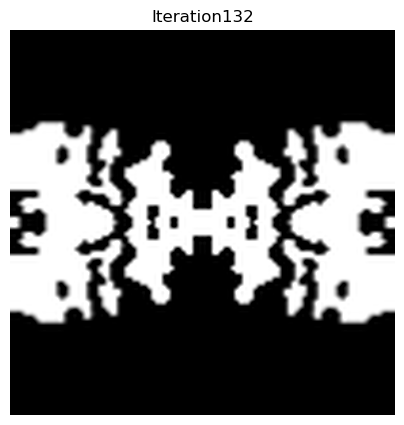

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


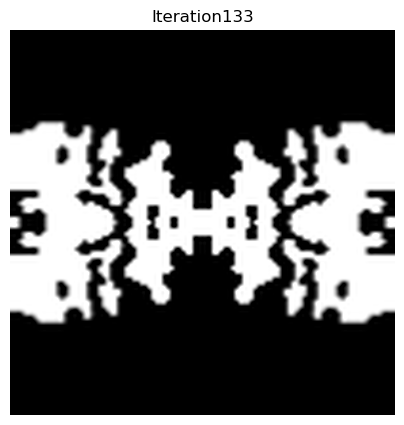

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
1024
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


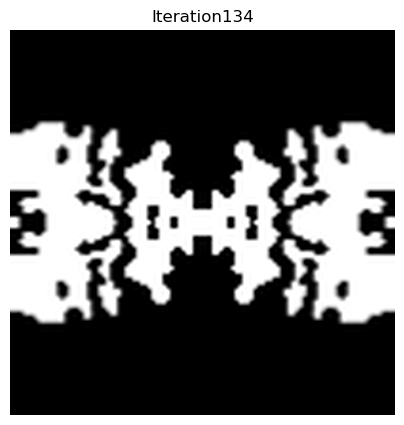

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


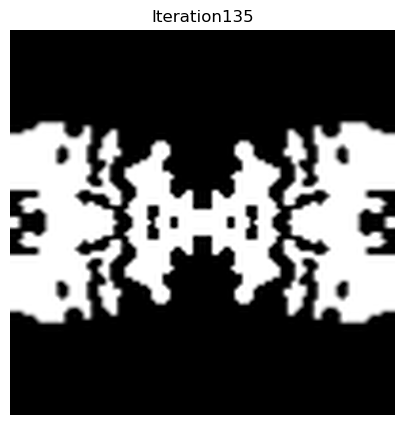

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


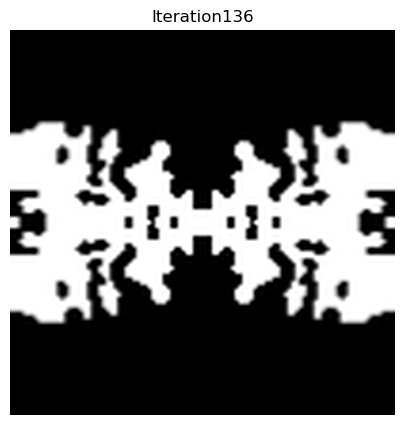

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


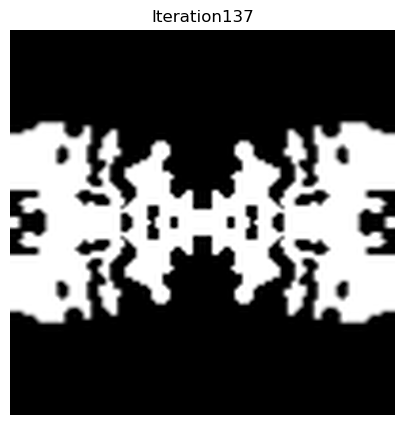

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


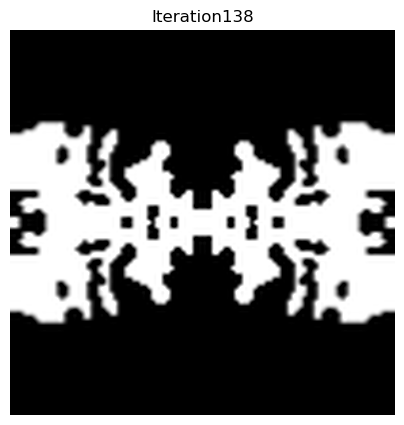

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


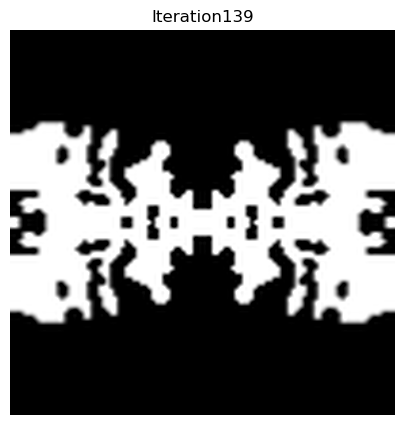

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


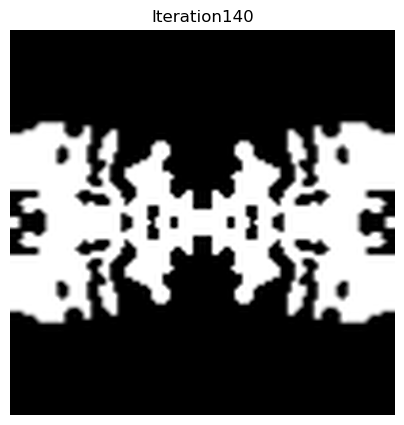

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


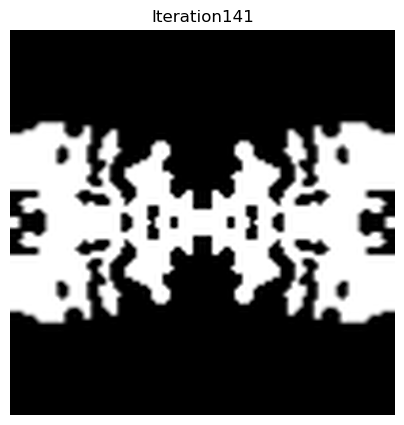

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


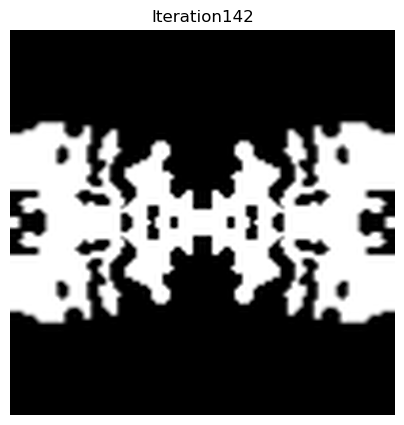

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


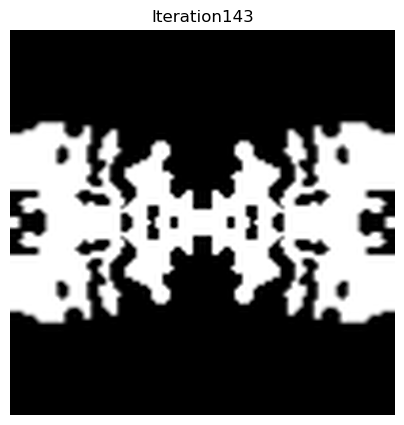

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


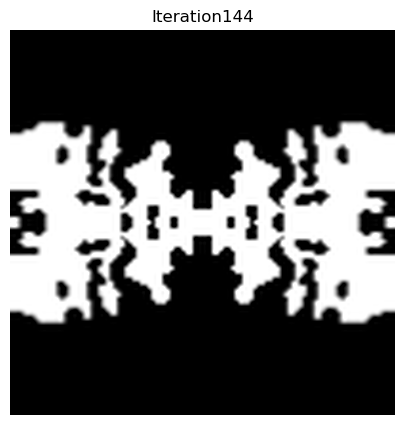

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


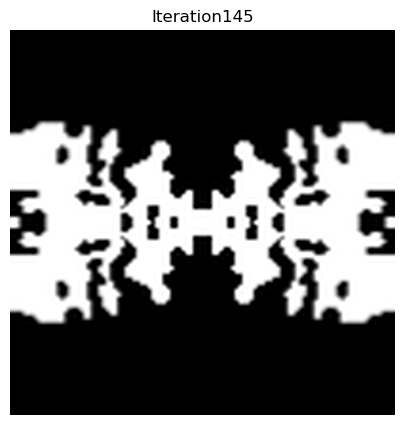

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


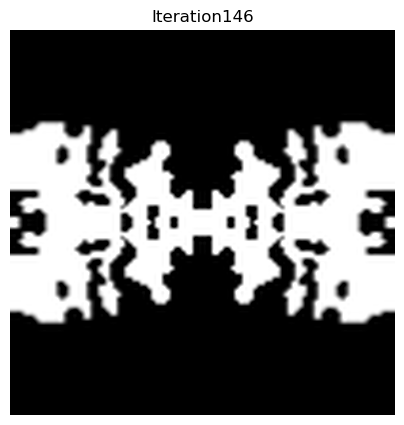

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


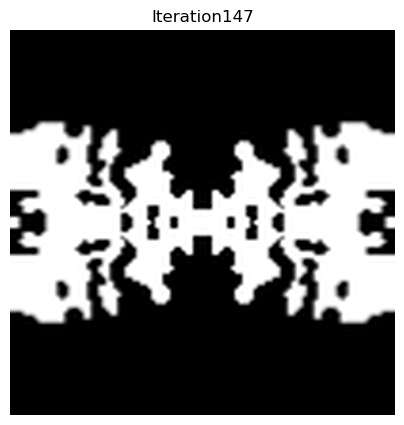

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


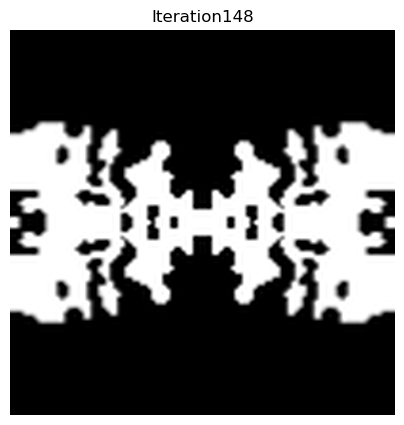

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
2048
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


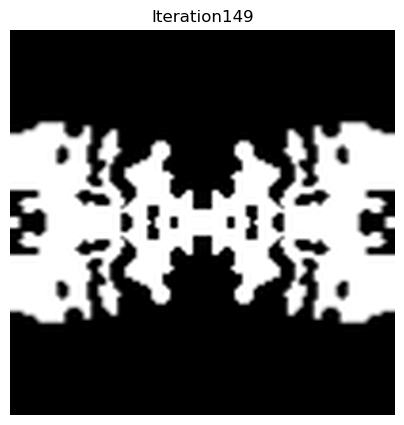

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


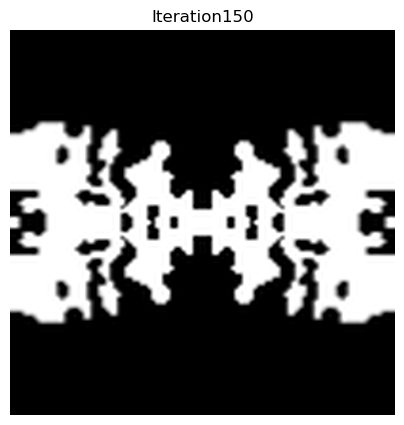

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


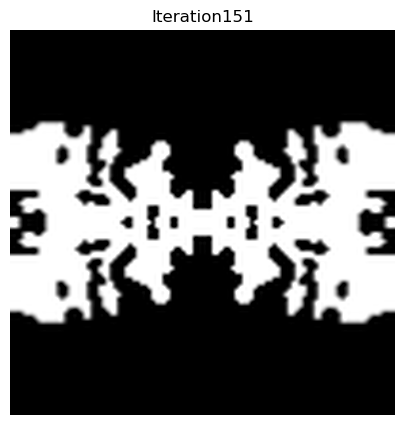

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


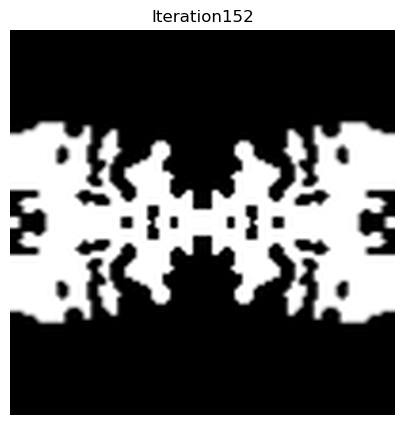

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


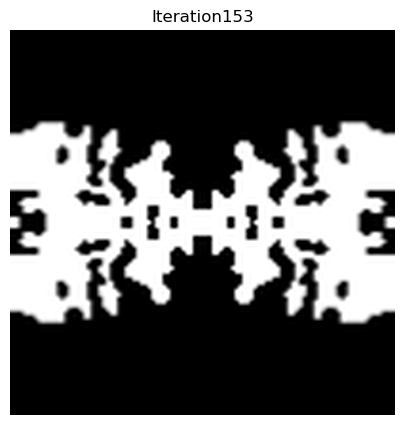

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


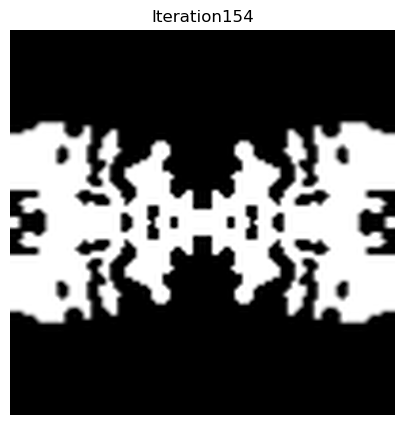

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


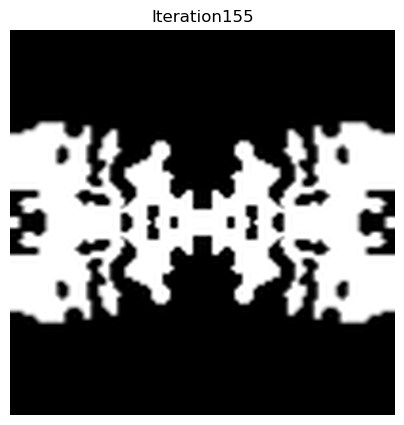

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


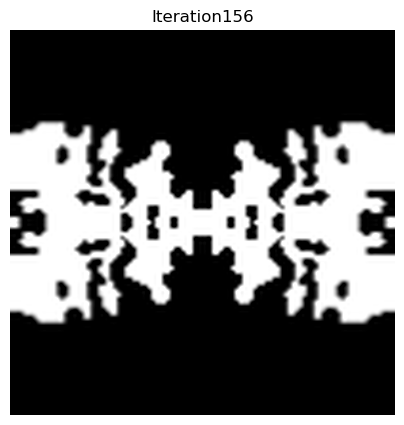

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


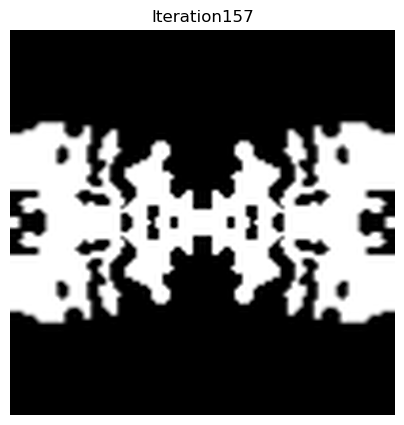

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


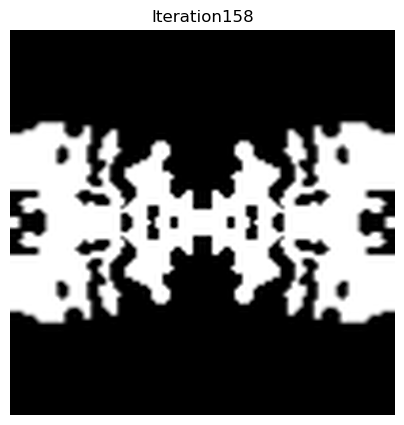

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


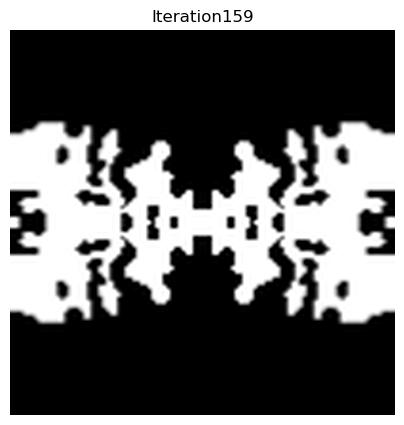

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


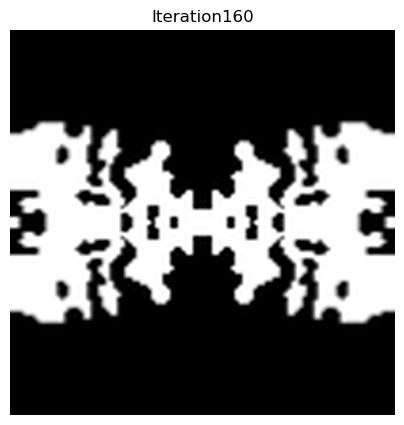

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


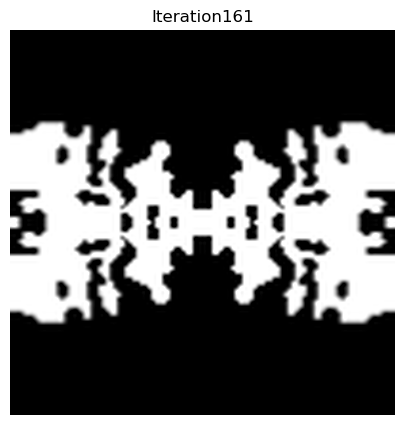

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


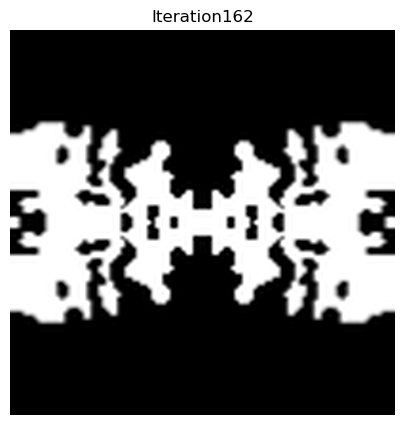

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


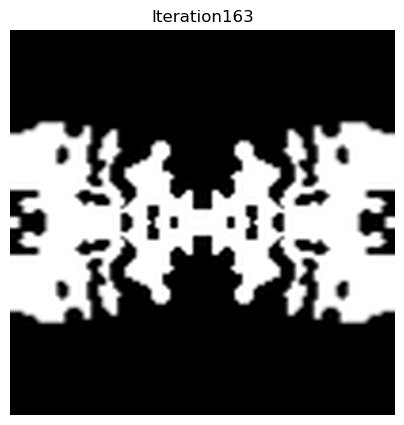

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
4096
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


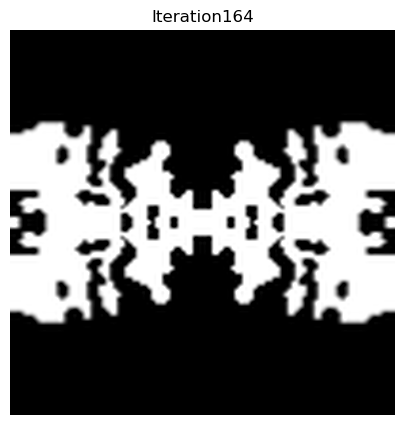

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


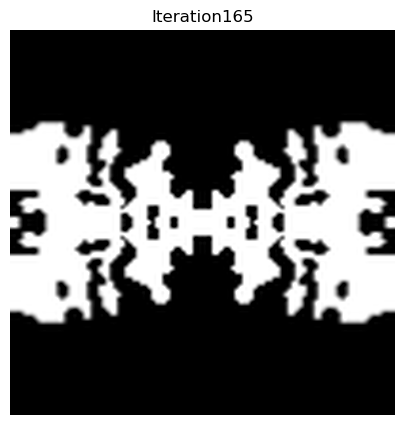

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


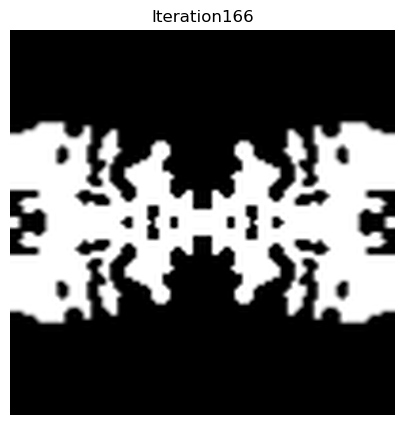

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


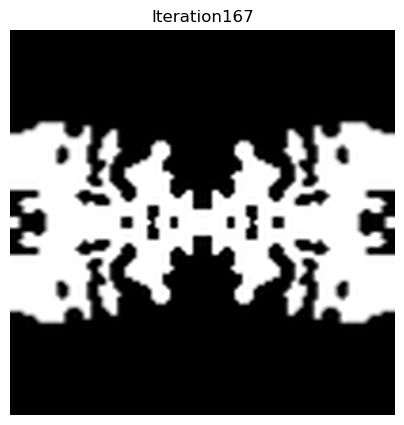

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


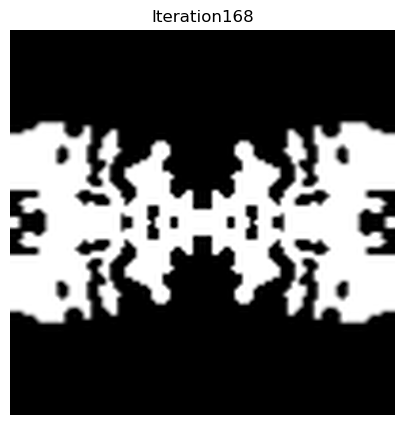

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


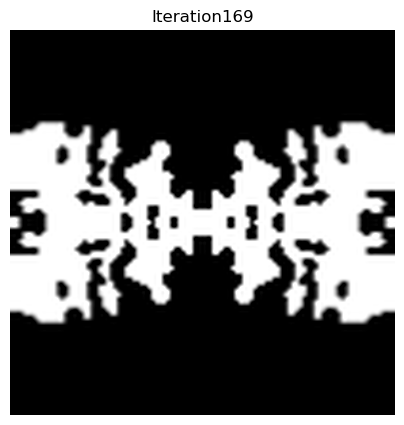

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


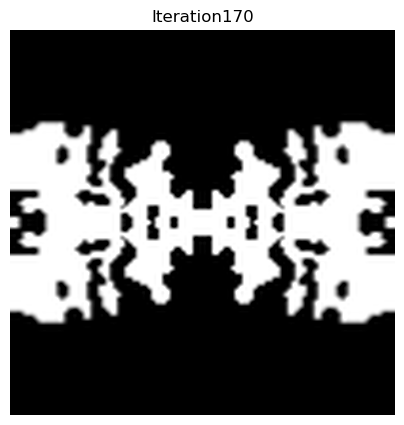

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


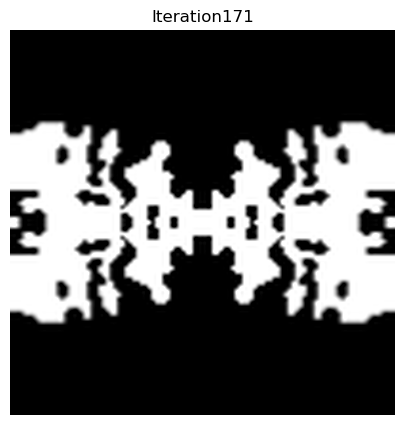

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


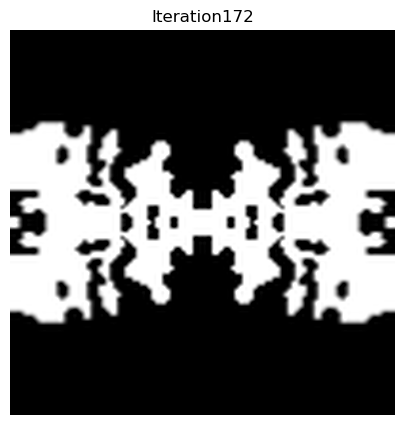

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


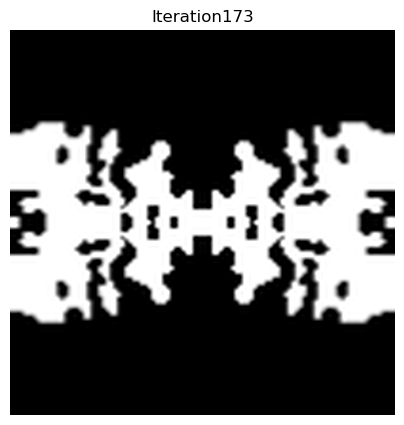

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


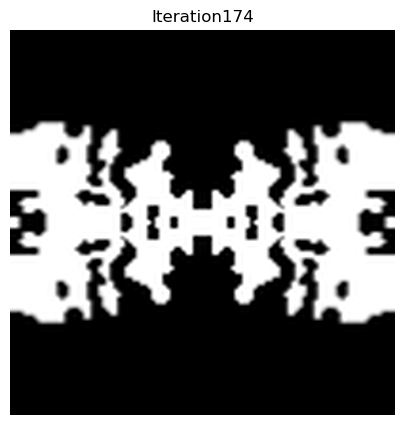

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


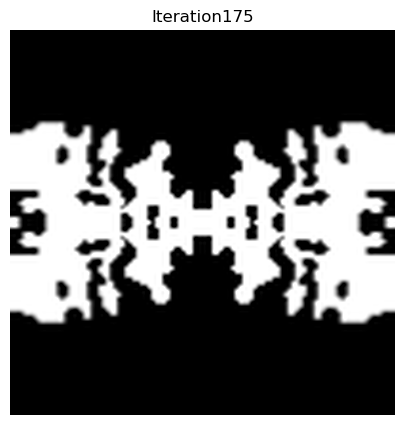

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


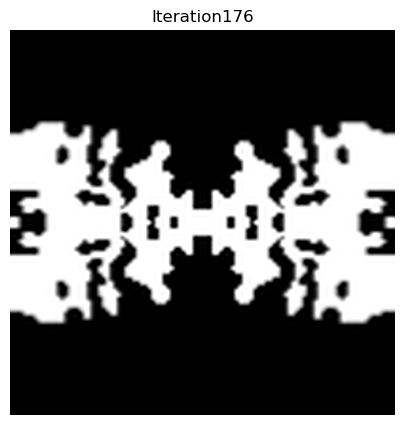

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


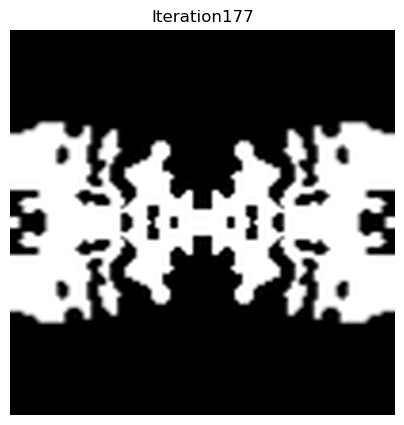

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


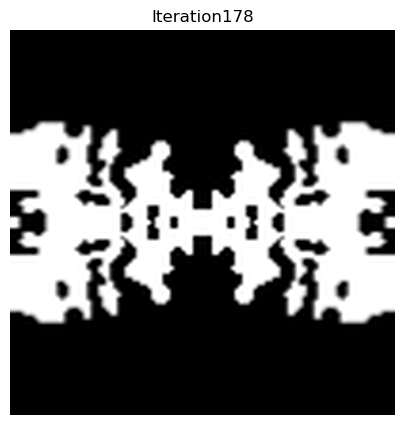

[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]
2
0.5
8192
[0.52579255 0.51869621 0.51604031 ... 0.51604031 0.51869621 0.52579255]


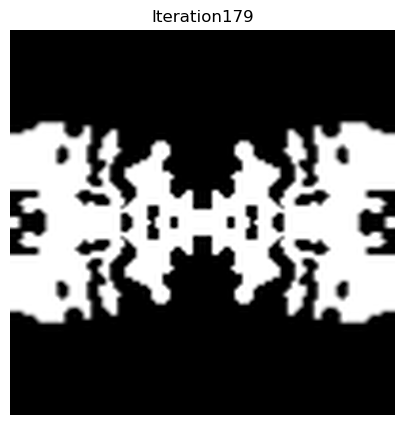

In [3]:
for i in range(1,180):
    v_array = np.load(f'Post_v_array{i:03d}.npy')
    print(v_array)
    beta_A = np.load(f'Post_beta_scale_array{i:03d}.npy')
    print(beta_A)
    eta_A = np.load(f'Post_eta_i_array{i:03d}.npy')
    print(eta_A)
    cur_A = np.load(f'Post_cur_beta_array{i:03d}.npy')
    print(cur_A)
    x_A = np.load(f'Post_x_array{i:03d}.npy')
    print(x_A)
    


    opt.update_design([mapping(v_array, eta_A, cur_A/beta_A)]) # cur_beta/beta_scale is the final beta in the optimization.
    plt.figure(figsize=(5, 5))
    plt.title(f"Iteration{i :03d}")
    ax = plt.gca()
    opt.plot2D(
        False,
        ax=ax,
        plot_sources_flag=False,
        plot_monitors_flag=False,
        plot_boundaries_flag=False,
        output_plane = mp.Volume(center=mp.Vector3(0,0,0), size=mp.Vector3(design_region_x_width, design_region_y_height, 0))
    )
    circ = Circle((2, 2), minimum_length / 2)
    ax.add_patch(circ)
    ax.axis("off")
    plt.savefig(f'PICTURE/Picture{i:03d}.png')
    plt.show()


    

In [4]:
import os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from PIL import Image

# Set the directory where your images are stored
image_folder = "PICTURE"
image_files = sorted([os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith(".png")])  # Adjust for JPG, etc.

# Load images using PIL
images = [Image.open(img) for img in image_files]

# Create figure and axis
fig, ax = plt.subplots()
ax.axis("off")  # Hide axis
im = ax.imshow(images[0])  # Initialize with the first image

# Animation function
def update(frame):
    im.set_array(images[frame])
    return [im]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=len(images), interval=200, blit=True)
plt.close(fig)
# Display in Jupyter Notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


In [5]:
# Convert images to GIF
output_gif = "animation.gif"

# Save images as an animated GIF
images[0].save(
    output_gif,
    save_all=True,
    append_images=images[1:],
    duration=200,  # 每幀持續時間 (毫秒)
    loop=0         # 0 表示無限循環
)

print(f"GIF 已儲存至 {output_gif}")

GIF 已儲存至 animation.gif
